# MTH3302 : Méthodes probabilistes et statistiques pour l'I.A.

Jonathan Jalbert<br/>
Professeur adjoint au Département de mathématiques et de génie industriel<br/>
Polytechnique Montréal<br/>


Le projet a été préparé par Gabriel Gobeil, associé de recherche à Polytechnique Montréal.

---
# Projet A2022 : Récolte des cerfs de Virginie


La description du projet est disponible à l'adresse suivante : https://www.kaggle.com/t/23b6d8c44f1247c78e19a6a902f804af

Ce calepin Jupyter de base permet de charger et de nettoyer les données fournies. La dernière section détaille la génération du fichier des prédictions afin de le soumettre sur Kaggle dans le bon format.

## Données

Les données disponibles pour le sujet sont les suivantes :
- recolte.csv
- permis.csv
- meteo.csv
- essence.csv
- test.csv

## Equipe Y
| Nom | Matricule |
| --- | --- |
| BRANLY Stéphane | (matricule 2232279) | 
| GOLLIOT Quentin | (matricule 2149749) |
| HUARD Éric      | (matricule 2228242) |


In [1]:
using CSV, DataFrames, Statistics, Dates, Gadfly, ColorSchemes, Impute, StatsBase, MLJ, LinearAlgebra, Distributions

# on retire l'ambiguité de la fonction transform
transform = DataFrames.transform

transform (generic function with 4 methods)

---
## 1. Chargement de données

#### Récolte annuelle de cerfs par zones de chasse selon les différents engins

In [2]:
recolte = CSV.read("data/recolte.csv", DataFrame)
first(recolte, 5)

,Année,Zone,Engin,Cerfs
,Int64,Int64,String15,Int64
1,1999,2,Arc,58
2,1999,2,Carabine,852
3,1999,2,Indéterminé,12
4,1999,3,Arc,94
5,1999,3,Carabine,1422


#### Nombre de permis de chasse alloués annuellement aux résidents et non-résidents

In [3]:
permis = CSV.read("data/permis.csv", DataFrame)
first(permis, 5)

,Année,Résidents,Résidents premier abbatage,Non-résidents,Total
,Int64,Int64,Int64?,Int64,Int64
1,1998,135409,missing,1230,136639
2,1999,131325,missing,1260,132585
3,2000,137346,missing,1463,138809
4,2001,144074,missing,1551,145625
5,2002,151154,missing,1735,152889


#### Moyenne mensuelle du prix de détail de l'essence en cents pour Québec et Montréal

In [4]:
essence = CSV.read("data/essence.csv", DataFrame)
first(essence, 5)

,Mois,Québec,Montréal
,Date,Float64,Float64
1,1997-04-01,60.1,60.3
2,1997-05-01,60.7,60.5
3,1997-06-01,59.4,61.5
4,1997-07-01,57.9,59.7
5,1997-08-01,62.8,64.0


#### Données météorologiques quotidiennes à Montréal-Trudeau entre 1999 et 2021

In [5]:
meteo = CSV.read("data/meteo.csv", DataFrame)
first(meteo, 5)

,Date/Time,Mean Temp (°C),Total Rain (mm),Total Snow (cm),Snow on Grnd (cm)
,Date,Float64?,Float64?,Float64?,Int64?
1,1999-01-01,-20.5,0.0,1.0,2
2,1999-01-02,-19.2,0.0,0.0,2
3,1999-01-03,-8.5,1.2,11.4,7
4,1999-01-04,-9.4,0.0,0.0,8
5,1999-01-05,-14.3,0.0,0.0,8


---
## 2. Analyse exploratoire

Nous commençons tout d'abord par une analyse exploratoire des données que nous pourrons comparer en parallèle avec de la documentation existante sur le sujet. Nous cherchons ici des informations basiques sur nos données: de quelles variables disposons nous, y a-t-il des valeurs manquantes, comment évoluent ces données / comment sont-elles distribuées, et éventuellement ont-elles un lien évident avec la valeur à prédire (la quantité de cerfs récoltés).

### 2.1 Contenu des dataframes

#### Récolte

In [17]:
describe(recolte)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,DataType
1,Année,2010.2,1999,2010.0,2020,0,Int64
2,Zone,9.40041,1,8.0,28,0,Int64
3,Engin,,ACB,,Indéterminé,0,String15
4,Cerfs,492.294,0,50.0,7943,0,Int64


In [18]:
unique(recolte.Engin)

6-element Vector{String15}:
 "Arc"
 "Carabine"
 "Indéterminé"
 "ACB"
 "Arbalète"
 "Fusil"

Nous remarquons que les collectes sont séparées en `Année`, `Zone` et `Engin`.

#### Permis

In [19]:
describe(permis)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Int64,Float64,Int64,Int64,Type
1,Année,2009.0,1998,2009.0,2020,0,Int64
2,Résidents,1.46421e5,126315,143829.0,171684,0,Int64
3,Résidents premier abbatage,9081.92,8369,8951.0,9816,11,"Union{Missing, Int64}"
4,Non-résidents,1266.65,691,1230.0,1830,0,Int64
5,Total,1.52426e5,132585,152889.0,173330,0,Int64


Nous remarquons des valeurs manquantes pour la colonne `Résidents premier abbatage`

#### Météo

In [20]:
describe(meteo)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Any,Any,Int64,Type
1,Date/Time,,1999-01-01,2009-12-31,2021-12-31,0,Date
2,Mean Temp (°C),7.47565,-26.5,8.1,30.1,18,"Union{Missing, Float64}"
3,Total Rain (mm),2.29677,0.0,0.0,73.8,26,"Union{Missing, Float64}"
4,Total Snow (cm),0.573052,0.0,0.0,45.6,13,"Union{Missing, Float64}"
5,Snow on Grnd (cm),4.12935,0,0.0,51,2006,"Union{Missing, Int64}"


Nous remarquons des valeurs manquantes pour les colonnes `Mean Temp (°C)`, `Total Rain (mm)`, `Total Snow (cm)` et `Snow on Grnd (cm)`

En regardant le fichier csv, on se rend compte que les nombreuses données manquantes pour Snow on Grnd correspondent majoritairement à des dates en dehors des périodes hivernales à partir de 2011. On devrait pouvoir les remplacer par 0 sans créer de problème. Les autres données manquantes peuvent être définies par interpolation.

#### Essence


In [21]:
describe(essence)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Any,Any,Int64,DataType
1,Mois,,1997-04-01,2009-12-01,2022-08-01,0,Date
2,Québec,103.841,51.8,105.7,219.7,0,Float64
3,Montréal,105.648,52.2,107.4,216.5,0,Float64


#### Remarques

Nous pouvons noter que nous avons principalement des variables de type quantitatives. Seulement les `Engins` et `Zone` sont de type qualitatives nominales.

### 2.2 Géographie

Afin de mieux comparer le comportement dans différentes zones, il est primordial de prendre connaissance de la géographie des zones.

<img src="https://cdn-contenu.quebec.ca/cdn-contenu/chasse/Images/ZonesChasse.jpg" alt="Carte de chasse quebec" width="400"/>
          
Nous pouvons noter que :
* La superficie des zones varie beaucoup
* La zone `20` est un ile isolée
* La zone `21` correspond au fleuve et golfe Saint-Laurent

### 2.3 Quantité de cerfs récoltés annuellement dans toutes les zones pour tous les engins de chasse

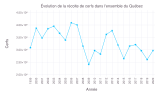

In [22]:
set_default_plot_size(16cm, 10cm)
df = combine(groupby(recolte, :Année), :Cerfs => sum => :Cerfs)
plot(df, x=:Année, y=:Cerfs, Guide.xticks(ticks=[1999:2020;]), Geom.line, Geom.point, Guide.title("Évolution de la récolte de cerfs dans l'ensemble du Québec"))

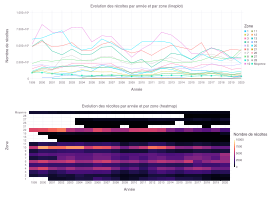

In [23]:
set_default_plot_size(27cm, 20cm)

df = combine(groupby(recolte, [:Zone, :Année]), :Cerfs => sum => :Cerfs)
moyenne_df = combine(groupby(recolte, :Année), :Cerfs => mean => :Cerfs)
moyenne_df.Zone .= "Moyenne"

lineplot = plot(df, 
    x=:Année, Guide.xticks(ticks=[1999:2020;]),
    y=:Cerfs,
    color=:Zone, Scale.color_discrete, 
    Geom.line,
    Guide.ylabel("Nombre de récoltes"), Guide.title("Evolution des récoltes par année et par zone (lineplot)"),
    layer(moyenne_df, x=:Année, y=:Cerfs, Geom.line, Geom.point, color=["Moyenne"]),
)

heatmap = plot(df, 
    x=:Année, Guide.xticks(ticks=[1999:2020;]),
    y=:Zone, Scale.y_discrete,
    color=:Cerfs, Guide.colorkey(title="Nombre de récoltes"), Scale.ContinuousColorScale(palette -> get(ColorSchemes.magma, palette)),
    Geom.rectbin,
    Guide.title("Evolution des récoltes par année et par zone (heatmap)"),
    layer(moyenne_df, x=:Année, y=:Zone, Geom.rectbin, color=:Cerfs),
)

vstack(lineplot, heatmap)

Ici nous pouvons remarquer plusieurs choses :
* L'ordre de grandeur du nombre de récoles par zone n'est pas le même. Ceci peut s'expliquer par la superficie des zones de chasse dans chaque zone qui est différente et par la différence population humaine de ces zones (nous ne savons par contre pas où vivent majoritairement les cerfs au Québec donc nous ne ferons pas d'hypothèses dessus).
* Certaines zones ont des données manquantes pour certaines année (par exemple pour les zones `28`, `27`, `26`, `21`, `15`, `13`,  `12`, `1`)


Maintenant, pour essayer de comparer la tendance de chaque zone entre elles, nous faisons la différence d'une année avec celle précédente puis nous normalisons sur une échelle min-max pour chaque zone.

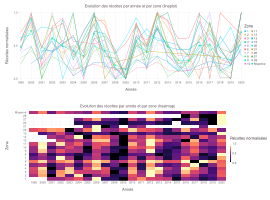

In [24]:
set_default_plot_size(27cm, 20cm)

df = combine(groupby(recolte, [:Zone, :Année]), :Cerfs => sum => :Cerfs)
df.Diff .= convert(Array{Float64,1}, df.Cerfs)

for zone in unique(df.Zone)
    for année in 1999:2020
        valeur1 = df[(df.Zone .== zone) .& (df.Année .== année-1), :Cerfs]
        valeur2 = df[(df.Zone .== zone) .& (df.Année .== année), :Cerfs]
        if length(valeur1) == 1 & length(valeur2) == 1
            df[(df.Zone .== zone) .& (df.Année .== année), :Diff] .= (valeur2-valeur1)
        else 
            df[(df.Zone .== zone) .& (df.Année .== année), :Diff] .= 0
        end
    end
    mini = minimum(df[df.Zone .== zone, :Diff])
    maxi = maximum(df[df.Zone .== zone, :Diff])
    df[df.Zone .== zone, :Diff] .= (df[df.Zone .== zone, :Diff] .- mini) ./ (maxi .- mini)
end

moyenne_df = combine(groupby(df, :Année), :Diff => mean => :Diff)
moyenne_df.Zone .= "Moyenne"

lineplot = plot(df, 
    x=:Année, Guide.xticks(ticks=[1999:2020;]),
    y=:Diff,
    color=:Zone, Scale.color_discrete, 
    Geom.line,
    Guide.ylabel("Récoltes normalisées"), Guide.title("Evolution des récoltes par année et par zone (lineplot)"),
    layer(moyenne_df, x=:Année, y=:Diff, Geom.line, Geom.point, color=["Moyenne"]),
)

heatmap = plot(df, 
    x=:Année, Guide.xticks(ticks=[1999:2020;]),
    y=:Zone, Scale.y_discrete,
    color=:Diff, Guide.colorkey(title="Récoltes normalisées"), Scale.ContinuousColorScale(palette -> get(ColorSchemes.magma, palette)),
    Geom.rectbin,
    Guide.title("Evolution des récoltes par année et par zone (heatmap)"),
    layer(moyenne_df, x=:Année, y=:Zone, Geom.rectbin, color=:Diff),
)

vstack(lineplot, heatmap)

Ici nous pouvons remarquer plusieurs points :
* la tendance de certaines zones semble similaire
* il y a des pics où la récolte était moindre comparé à l'année précédente (`2001`, `2005`, `2009`, `2019`). Par exemple pour l'année `2019`, ce pic de récolte moindre est accentué par une augmentation significative en `2020`.
* Les zones `20` ainsi que `6` ont une tendance de récoltes qui se distingue des autres zones pour le passage de l'année `2019` à l'année `2020`

Il est possible de visualiser la quantité de cerfs récoltés par zone sous forme d'histogrammes afin de visualiser leur distribution afin de voir si elles respectent certaines lois connues.

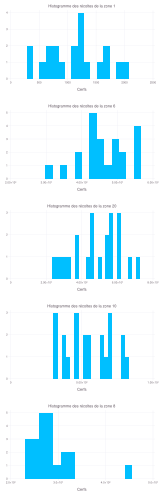

In [25]:
set_default_plot_size(16cm, 50cm)

df = combine(groupby(recolte, [:Zone, :Année]), :Cerfs => sum => :Cerfs)

histogram_arr = []

# for zone in unique(df.Zone)
for zone in [1, 6, 20, 10, 8]
    histogram = plot(df[df.Zone .== zone, :],
        x=:Cerfs,
        Geom.histogram,
        Guide.title("Histogramme des récoltes de la zone $(zone)")
    )
    push!(histogram_arr, histogram)
end

vstack(histogram_arr...)

Ne disposant que de peu d'années pour chaque zone, il est difficile de se prononcer sur la distribution que suit la quantité de cerfs par zone. Cependant, dans certaines zones comme la zone `20`, nous observons une distribution se rapprochant d'une distribution que l'on pourrait obtenir si la quantité de cerfs récoltés par zone suivait une loi normale.

### 2.4 Analyse de la météo

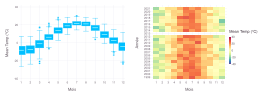

In [26]:
set_default_plot_size(26cm, 10cm)
df = copy(meteo)
df.Année .= DataFrames.transform(df, "Date/Time" => x->year.(x))[!,"Date/Time_function"]
df.Mois  .= transform(df, "Date/Time" => x->month.(x))[!,"Date/Time_function"]
df.Date  .= transform(df, "Date/Time" => x->Date.(2000,month.(x),day.(x)))[!,"Date/Time_function"]

rows = []

# la ligne suivante permet d'afficher pour chaque colonne, neanmoins cela est trop gourmant
# a l'affichage pour le navigateur. Nous affichons alors uniquement pour la température
# for col in names(select(df, Not(["Date/Time", "Année", "Mois", "Date"])))
for col in ["Mean Temp (°C)"]
    df = filter(col .=> c -> !ismissing(c) , df)
    lineplot = plot(df, x=:Mois, Guide.xticks(ticks=[1:12;]), y=col, Geom.boxplot)
    heatmap  = plot(df, 
        x=:Mois, Guide.xticks(ticks=[1:12;]),
        y=:Année, Guide.yticks(ticks=[1999:2021;]), 
        color=col,
        Scale.ContinuousColorScale(palette -> get(ColorSchemes.Spectral, 1-palette), 
            minvalue=min(df[!,col]...),
            maxvalue=max(df[!,col]...)),
        Geom.rectbin)
    push!(rows, hstack(lineplot, heatmap))
end
vstack(rows...)

Nous remarquons :
* une tendance de la météo, en particulier de la température similaire au fil des années
* une absence de données de météo pour l'année 2013
* une abscence d'information sur la neige au sol de mai à octobre pour les années `2015` jusque `2021`.

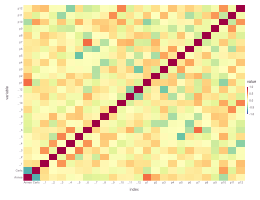

In [27]:
df = copy(meteo)
replace!(df[!,"Snow on Grnd (cm)"], missing => 0.0);
df = Impute.interp(df) |> Impute.locf() |> Impute.nocb();
df.Année .= DataFrames.transform(df, "Date/Time" => x->year.(x))[!,"Date/Time_function"]
df[!,"Année"] .= DataFrames.transform(df, "Date/Time" => x->year.(x))[!,"Date/Time_function"];
df[!,"Mois"]  .= transform(df, "Date/Time" => x->month.(x))[!,"Date/Time_function"];
df_meteo = combine(groupby(df, [:Année, :Mois]), "Mean Temp (°C)" => mean => :Mean_Temp);
df_recolte = combine(groupby(recolte, :Année), :Cerfs => sum => :Cerfs);

col_names = [:Annee, :Cerfs, :_1, :_2, :_3, :_4, :_5, :_6, :_7, :_8, :_9, :_10, :_11, :_12,
    :p1, :p2, :p3, :p4, :p5, :p6, :p7, :p8, :p9, :p10, :p11, :p12] # needs to be a vector Symbols
col_types = [Float64 for i in 1:26]# Create a NamedTuple (A=Int64[], ....) by doing
named_tuple = (; zip(col_names, type[] for type in col_types )...);
df5 = DataFrame(named_tuple) # 0×2 DataFrame
for annee in unique(df_meteo.Année)
    if annee ∉ [1999, 2014, 2021]
        row = Float64[]
        append!(row,annee)
        append!(row, df_recolte[df_recolte.Année.==annee,:].Cerfs[1])
        for mois in unique(df_meteo.Mois)
            append!(row, df_meteo[df_meteo.Année.==annee .&& df_meteo.Mois.==mois, :].Mean_Temp)
            append!(row, df_meteo[df_meteo.Année.==annee-1 .&& df_meteo.Mois.==mois, :].Mean_Temp)
        end
        push!(df5, row)
    end
end
set_default_plot_size(26cm, 20cm)
correlation_matrix = cor(Matrix(dropmissing(df5)))
df_corr = DataFrame(correlation_matrix, names(df5))
df_corr.index = names(df5);
plot(stack(df_corr), x=:index, y=:variable, color=:value, Geom.rectbin,
Scale.ContinuousColorScale(palette -> get(ColorSchemes.Spectral, 1-palette)))

Les variables commençant par un `_` correspondent aux mois de l'année en cours. Ainsi, `_1`est janvier dl'année en cours. Les variables commençant par `p`correspondent aux mois de l'année précédente. Ainsi, `p1` correspond au premier mois de l'année précédente.

On remarque que les mois sont faiblement corrélés entre eux, prendre une moyenne des températures sur toute l'année (ou un seul jour/mois/... pour une année entière) risquerait de faire perdre de l'information. De manière générale, on remarque que les températures moyennes des mois de l'année en cours et de l'année précédente sont assez faiblement corrélés à la récolte de l'année. Les mois dont les températures moyennes sont les plus corrélés à la récolte de cerfs sont octobre de l'année précédente (positif, +0.446), janvier de l'année précédente (-0.298) et janvier de l'année présente (+0.215).

Nous n'allons pas étendre cette analyse assez fastidieuse aux autres données météorologiques. A la place, nous allons plutôt commencer par considérer toutes les varaibles possibles puis nous éliminerons celles avec une corrélation trop faible par rapport à la récolte de cerfs.

### 2.5 Analyse de l'essence

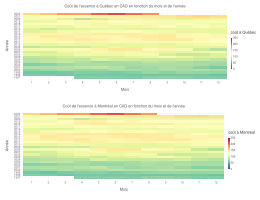

In [28]:
set_default_plot_size(26cm, 20cm)
df = copy(essence)
df.Année .= DataFrames.transform(df, "Mois" => x->year.(x))[!,"Mois_function"]
df.Reel_mois  .= transform(df, "Mois" => x->month.(x))[!,"Mois_function"]
df.Date  .= transform(df, "Mois" => x->Date.(2000,month.(x),day.(x)))[!,"Mois_function"]
rename!(df,:Québec => :"coût à Québec");
rename!(df,:Montréal => :"coût à Montréal");

rows = []
for col in names(select(df, Not(["Mois", "Année", "Reel_mois", "Date"])))
    df = filter(col .=> c -> !ismissing(c) , df)
    if col=="coût à Québec"
        city = "Québec"
    else
        city = "Montréal"
    end
    heatmap  = plot(df, 
        x=:Reel_mois, Guide.xticks(ticks=[1:12;]),
        y=:Année, Guide.yticks(ticks=[1997:2022;]), 
        color=col,
        Scale.ContinuousColorScale(palette -> get(ColorSchemes.Spectral, 1-palette), 
            minvalue=min(df[!,col]...),
            maxvalue=max(df[!,col]...)),
        Guide.xlabel("Mois"),
        Guide.title("Coût de l'essence à "*city*" en CAD en fonction du mois et de l'année"),
        Geom.rectbin)
    push!(rows, heatmap)
end
vstack(rows...)

Nous remarquons une augmentation regulière du prix de l'essence d'année en année.
L'année `2022` se distingue amplement mais cette dernière n'est pas à prendre en compte pour la prédiction désirée qui est sur l'année 2021.

### 2.5 Nombre de permis vendus par année

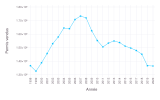

In [29]:
set_default_plot_size(16cm, 10cm)
plot(permis, x=:Année, y=:Total, Geom.line, Geom.point,
    Guide.xticks(ticks=unique(permis.Année)),
    Guide.ylabel("Permis vendus"))

### 2.6 Mise en relation du nombre de permis vendus avec le nombre de cerfs récoltés

Corrélation de Pearson entre les cerfs abbatus et les permis vendus : 0.3673767349953668


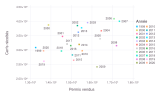

In [30]:
set_default_plot_size(16cm, 10cm)
df = innerjoin(combine(groupby(recolte, [:Année]), :Cerfs => sum => :Cerfs), permis, on = :Année)
println("Corrélation de Pearson entre les cerfs abbatus et les permis vendus : ",cor(df.Total, df.Cerfs))
plot(df, 
    x=:Total,
    y=:Cerfs,
    label=["$(i)" for i in unique(df.Année)],
    Geom.label,
    Geom.point,
    color=:Année, Scale.color_discrete, 
    Guide.xlabel("Permis vendus"),
    Guide.ylabel("Cerfs récoltés")
)

On remarque une légère corrélation positive entre le nombre de permis vendus et le nombre de cerfs récoltés. Remarquons tout de même qu'on ne connaît pas le nombre de permis vendus pour 2021, l'année à prédire. Comme il semblerait que les permis soient à renouveller chaque année, utiliser le nombre de permis de l'année précédente pour prédire le nombre de cerfs récoltés d'une année ne semble pas un choix logique, bien que possible. Comme nous voyons un plateau entre 2019 et 2020, on va supposer que ce plateau se poursuit en 2021 et on et on va dupliquer les valeurs de l'année 2020.

### 2.7 Correlation du nombre de cerfs recoltés entre les zones

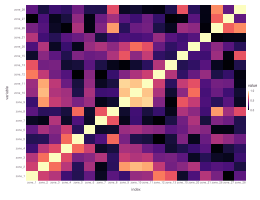

In [31]:
df = combine(groupby(recolte, [:Année, :Zone]), :Cerfs => sum => :Cerfs)

colnames = ["Année"]
[push!(colnames,"zone_$(zone)") for zone in sort(unique(df.Zone))]
df2 = DataFrame(ones(size(unique(df.Année))[1], size(unique(df.Zone))[1]+1), colnames)
df2.Année .= unique(df.Année)
for année in unique(df2.Année)
    for zone in unique(df.Zone)
        filtered = df[df.Année .== année .&& df.Zone .== zone, :Cerfs]
        if length(filtered) > 0
            df2[df2.Année .== année, "zone_$(zone)"] .= filtered[1]
        else
            df2[df2.Année .== année, "zone_$(zone)"] .= mean(df[df.Zone .== zone, :Cerfs])
        end
    end
end

set_default_plot_size(26cm, 20cm)
function get_correlation_matrix(df::DataFrame)
    df2 = copy(df)
    df2 = Impute.interp(df2) |> Impute.locf() |> Impute.nocb();
    correlation_matrix = cor(Matrix(df2))
    (n,m) = size(correlation_matrix)
    df_corr = DataFrame(abs.(correlation_matrix), names(df))
    df_corr.index = names(df)
    return df_corr
end;

df_corr_zones = get_correlation_matrix(select(df2, Not(:Année)))

function plot_correlation_matrix(df::DataFrame)
    stacked = stack(df)
    plot(stacked, 
        x=:index,
        y=:variable,
        color=:value,
        Scale.ContinuousColorScale(
            palette -> get(ColorSchemes.magma, palette),
            minvalue=min(0),
            maxvalue=max(1)),
        Geom.rectbin)
end

plot_correlation_matrix(df_corr_zones)

On remarque une forte corrélation entre les zones `9`,`10`,`11` et `2`.
En effet les zones `9`, `10` et `11` sont adjascentes, néanmoins la zone `2` est détachée de ces zones.

Nous pouvons créer un dict d'array contenant les valeurs des zones corrélées pour chaque zone.

In [32]:
corr_threshold = 0.4
zone_correlees = Dict()
for i in 1:size(df_corr_zones[:, Not(:index)])[1]
    current_zone_corr = []
    for j in 1:size(df_corr_zones[:, Not(:index)])[1]
        if df_corr_zones[i, j] > corr_threshold
            push!(current_zone_corr, parse(Int64, replace(names(df_corr_zones)[j], "zone_" => "")))
        end
    end
    zone_correlees[parse(Int64, replace(names(df_corr_zones)[i], "zone_" => ""))] = current_zone_corr
end

zone_correlees

Dict{Any, Any} with 19 entries:
  5  => Any[4, 5, 8, 26, 27]
  20 => Any[2, 6, 7, 9, 10, 11, 20, 26]
  12 => Any[1, 2, 10, 11, 12, 13, 21]
  28 => Any[8, 15, 26, 28]
  8  => Any[5, 7, 8, 15, 26, 27, 28]
  1  => Any[1, 2, 3, 10, 11, 12, 13, 21]
  6  => Any[2, 4, 6, 9, 10, 11, 20]
  11 => Any[1, 2, 3, 6, 9, 10, 11, 12, 15, 20]
  9  => Any[2, 3, 4, 6, 9, 10, 11, 15, 20]
  3  => Any[1, 2, 3, 4, 7, 9, 10, 11]
  7  => Any[3, 7, 8, 20]
  4  => Any[2, 3, 4, 5, 6, 9, 10]
  13 => Any[1, 12, 13]
  15 => Any[8, 9, 11, 15, 26, 28]
  2  => Any[1, 2, 3, 4, 6, 9, 10, 11, 12, 20]
  10 => Any[1, 2, 3, 4, 6, 9, 10, 11, 12, 20]
  21 => Any[1, 12, 21]
  26 => Any[5, 8, 15, 20, 26, 27, 28]
  27 => Any[5, 8, 26, 27]

Dictionnaire de corrélation de chaque zone avec les autres zones les plus corrélées.

### 2.8 Corrélation dans les données d'entrée

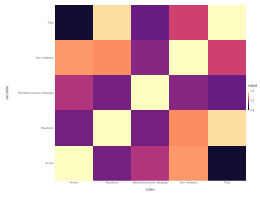

In [33]:
df_corr = get_correlation_matrix(permis)
plot_correlation_matrix(df_corr)

On remarque une corrélation assez importante entre `Total` et les trois variables `Résidents`, `Résidents premier abbatage` ainsi que `Non-Résidents`. Ce qui est plutot cohérent étant donné que `Total` est la somme.

In [367]:
df_corr = get_correlation_matrix(select(essence, Not(:Mois)))

,Québec,Montréal,index
,Float64,Float64,String
1,1.0,0.993008,Québec
2,0.993008,1.0,Montréal


Ici la corrélation est plus que remarquable entre `Montréal` et `Québec`. Nous pouvons nous contenter d'un seule de ces deux valeurs par la suite.

Nous avons déjà montré les corrélations pour les données météorologiques dans une partie précédente (du moins, les corrélations à l'intérieur de la variable température, montrer cette analyse pour toutes les variables n'apporte pas grand chose de plus) donc ce ne sera pas à nouveau développé dans cette partie.


## 3. Complétion des données manquantes, nettoyage des données et création du dataframe

### 3.1 Résumé du prix de l'essence par la moyenne par année

In [34]:
first(essence, 1)

,Mois,Québec,Montréal
,Date,Float64,Float64
1,1997-04-01,60.1,60.3


Nous calculons la moyenne du prix de l'essence sur toute l'année et nous conservons que la ville de Québec comme référence.

In [35]:
essence_par_année = combine(groupby(transform(Impute.interp(essence) |> Impute.locf() |> Impute.nocb(), :Mois => x->year.(x)), :Mois_function), [:Québec => mean => :Moyenne_Québec_essence])
rename!(essence_par_année, :Mois_function => :Année)
first(essence_par_année, 1)

,Année,Moyenne_Québec_essence
,Int64,Float64
1,1997,60.5778


### 3.2 Résumé des données météorologiques par mois
* Température moyenne
* Cumul de la pluie tombée
* Cumul de la neige tombée
* Moyenne du tapis neigeux

In [36]:
first(meteo, 1)

,Date/Time,Mean Temp (°C),Total Rain (mm),Total Snow (cm),Snow on Grnd (cm)
,Date,Float64?,Float64?,Float64?,Int64?
1,1999-01-01,-20.5,0.0,1.0,2


On impute les données manquantes par interpolation si possible, sinon nous remplacons par la valeur précédente la plus proche, sinon par la valeur suivante la plus proche.

In [37]:
meteo_cp = copy(meteo)
replace!(meteo_cp[!,"Snow on Grnd (cm)"], missing => 0.0);

# ici, on duplique l'année 2014 et on considere l'année 2013 identique à l'année 2014
meteo_2014 = copy(meteo_cp[transform(meteo_cp, "Date/Time" => x->year.(x))[!,"Date/Time_function"] .== 2014, :])
meteo_2014[!, "Date/Time"] .= transform(meteo_2014, "Date/Time" => x->Date.(year.(x).+1, month.(x), day.(x)))[!,"Date/Time_function"]

meteo_cp = vcat(meteo_cp, meteo_2014)
meteo_cp = Impute.interp(meteo_cp) |> Impute.locf() |> Impute.nocb()

for col in names(select(meteo_cp, Not("Date/Time")))
    meteo_cp[!, col] .= convert(Array{Union{Missing, Float64},1}, meteo_cp[!, col])
end
describe(meteo_cp)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Any,Any,Int64,DataType
1,Date/Time,,1999-01-01,2010-07-02,2021-12-31,0,Date
2,Mean Temp (°C),7.46409,-26.5,8.1,30.1,0,Float64
3,Total Rain (mm),2.30037,0.0,0.0,73.8,0,Float64
4,Total Snow (cm),0.57017,0.0,0.0,45.6,0,Float64
5,Snow on Grnd (cm),3.09535,0.0,0.0,51.0,0,Float64


Nous calculons la moyenne de la température par année, le cumul de pluie tombée, le cumul de neige tombée ainsi que la moyenne de neige au sol.

Et nous résumons également les années par mois en prenant la moyenne et le minimum par mois pour chacune des variables.

In [38]:
meteo_par_année = combine(groupby(transform(meteo_cp, "Date/Time" => x->year.(x)), "Date/Time_function"), 
    ["Mean Temp (°C)" => mean => :Moyenne_température,
     "Total Snow (cm)" => sum => :Cumul_neige,
     "Total Rain (mm)" => sum => :Cumul_pluie,
     "Snow on Grnd (cm)" => mean => :Moyenne_neige_au_sol,
     ]
)
rename!(meteo_par_année,"Date/Time_function" => :Année)

colnames = ["Année"]

for mois in 1:12
    for col in names(select(meteo_cp, Not("Date/Time")))
        for value in ["Moyenne", "Min"]
            push!(colnames, "$(value)_$(col)_m$(mois)")
        end
    end
end

meteo_decoupee_par_mois = DataFrame(ones(length(unique(meteo_par_année.Année)), length(colnames)), colnames)
meteo_decoupee_par_mois.Année = unique(meteo_par_année.Année)
for année in unique(meteo_par_année.Année)
    meteo_de_l_année = meteo_cp[transform(meteo_cp, "Date/Time" => x->year.(x))[!,"Date/Time_function"] .== année, :]
    for mois in 1:12
        metéo_du_mois = meteo_de_l_année[transform(meteo_de_l_année, "Date/Time" => x->month.(x))[!,"Date/Time_function"] .== mois, :]
        info_du_mois = DataFrame()
        valeurs = Float64[]
        for c in names(select(metéo_du_mois, Not("Date/Time")))
            meteo_decoupee_par_mois[meteo_decoupee_par_mois.Année .== année,"Moyenne_$(c)_m$(mois)"] .= mean(metéo_du_mois[!,c])
            meteo_decoupee_par_mois[meteo_decoupee_par_mois.Année .== année,"Min_$(c)_m$(mois)"]  .= min(metéo_du_mois[!,c]...)
        end
    end
end

meteo_par_année = innerjoin(meteo_par_année, meteo_decoupee_par_mois, on=:Année)
first(meteo_par_année, 1)

,Année,Moyenne_température,Cumul_neige,Cumul_pluie,Moyenne_neige_au_sol,Moyenne_Mean Temp (°C)_m1
,Int64,Float64,Float64,Float64,Float64,Float64
1,1999,8.26562,171.7,769.1,2.08219,-9.22258


### 3.3 Complétion des données manquantes pour permis et récolte

On impute les données manquantes par interpolation si possible, sinon nous remplacons par la valeur précédente la plus proche, sinon par la valeur suivante la plus proche.

In [39]:
permis_cp  = Impute.interp(select(permis, [:Total, :Année])) |> Impute.locf() |> Impute.nocb();
recolte_cp = combine(groupby(recolte, [:Zone, :Année]), 
    :Cerfs => sum => :Cerfs, 
)

recolte_cp = Impute.interp(recolte_cp) |> Impute.locf() |> Impute.nocb();

Nous considérons qu'en 2021, il y a autant de permis qu'en 2020.

In [40]:
if size(permis_cp[permis_cp.Année .== 2021, :],1) == 0
    permis_2021 = permis_cp[permis_cp.Année .== 2020, :];
    permis_2021.Année .= 2021
    append!(permis_cp, permis_2021);
end
last(permis_cp,3)

,Total,Année
,Int64,Int64
1,136583,2019
2,136413,2020
3,136413,2021


### 3.4 Jointure de tous les dataframes sur l'année

Nous faisons une jointure gauche de tous les dataframes.
Nous effectuons ensuite une somme des cerfs par année (somme due aux engins différents utilisés pour la récolte), puis nous faisons la moyenne pour le reste des colonnes.

In [41]:
to_predict = CSV.read("data/test.csv", DataFrame)
a_predire = DataFrame(Année=fill(2021,length(to_predict.Zone)), Zone=to_predict.Zone, Cerfs=fill(0,length(to_predict.Zone)));

In [42]:
dataset2 = leftjoin(vcat(recolte_cp, a_predire), meteo_par_année, on = :Année)
dataset2 = leftjoin(dataset2, essence_par_année, on = :Année)
dataset2 = leftjoin(dataset2, permis_cp, on = :Année)
dataset2 = dataset2[dataset2.Année .== 2021 .|| .!ismissing.(:Cerfs), :]
dataset2 = Impute.interp(dataset2) |> Impute.locf() |> Impute.nocb();

Pour l'année 2021, nous avons les données nécessaires pour prédire le nombre de cerfs en fonction de la zone et du reste des variables.
A noter que `Zone` et `Cerfs` sont non Missing car ils ont été complétés lors de la phase précédente.
Nous devrons chercher la cible `Cerfs` et remplacer `Zone` par la zone d'intérêt.

In [43]:
filter(:Année => année -> année .== 2021, dataset2)

,Zone,Année,Cerfs,Moyenne_température,Cumul_neige,Cumul_pluie,Moyenne_neige_au_sol
,Int64,Int64,Int64,Float64?,Float64?,Float64?,Float64?
1,1,2021,0,8.66,177.2,624.9,5.19452
2,2,2021,0,8.66,177.2,624.9,5.19452
3,3,2021,0,8.66,177.2,624.9,5.19452
4,4,2021,0,8.66,177.2,624.9,5.19452
5,5,2021,0,8.66,177.2,624.9,5.19452
6,6,2021,0,8.66,177.2,624.9,5.19452
7,7,2021,0,8.66,177.2,624.9,5.19452
8,8,2021,0,8.66,177.2,624.9,5.19452
9,9,2021,0,8.66,177.2,624.9,5.19452


### 3.5 Ajout d'une fenetre glissante 
Nous ajoutons une fenetre glissante pour:
- le nombre de cerfs récoltés les années précédentes sur la zone concernée ainsi que séparément pour chaque zone
- le nombre de permis pour les années précendentes

In [47]:
deltas = [1,2,3]
colnames = ["Année"]
for zone in unique(dataset2.Zone)
    [push!(colnames, "Cerfs_année_delta_$(i)_zone_$(zone)") for i in deltas]
end

[push!(colnames, "Total_permis_delta_$(i)") for i in deltas]

fenetre_glissante_cerfs = DataFrame(ones(length(unique(dataset2.Année)),length(colnames)), colnames)
fenetre_glissante_cerfs.Année = unique(dataset2.Année)
for row in eachrow(fenetre_glissante_cerfs)
    année = row.Année
    for delta in deltas        
        colname = "Total_permis_delta_$(delta)"
        total_année_delta = dataset2[dataset2.Année .== année-delta, :Total]
        if length(total_année_delta) > 0
            row[colname] = total_année_delta[1]
        else
            row[colname] = mean(dataset2[!, :Total])
        end
        
        for zone in unique(dataset2.Zone)
            colname = "Cerfs_année_delta_$(delta)_zone_$(zone)"
            cerfs_année_delta = dataset2[dataset2.Année .== année-delta .&& dataset2.Zone .== zone, :Cerfs]

            if length(cerfs_année_delta) > 0
                row[colname] = cerfs_année_delta[1]
            else
                row[colname] = mean(dataset2[dataset2.Zone .== zone, :Cerfs])
            end
        end
    end
end

dataset3 = leftjoin(dataset2, fenetre_glissante_cerfs, on = :Année);

colnames = ["Année", "Zone"]
[push!(colnames, "Cerfs_zone_delta_$(i)") for i in deltas]

fenetre_glissante_cerfs = DataFrame(ones(size(dataset2,1),length(colnames)), colnames)
fenetre_glissante_cerfs.Année = dataset2.Année
fenetre_glissante_cerfs.Zone = dataset2.Zone
for row in eachrow(fenetre_glissante_cerfs)
    année = row.Année
    for delta in deltas
        colname = "Cerfs_zone_delta_$(delta)"
        cerfs_année_delta = dataset2[dataset2.Année .== année-delta .&& dataset2.Zone .== row.Zone, :Cerfs]

        if length(cerfs_année_delta) > 0
            row[colname] = cerfs_année_delta[1]
        else
            row[colname] = mean(dataset2[dataset2.Zone .== row.Zone, :Cerfs])
        end
    end
end

dataset3 = leftjoin(dataset3, fenetre_glissante_cerfs, on =[:Année, :Zone]);


total_cerfs_tues_par_annee = combine(groupby(recolte, :Année), :Cerfs => sum => :total_cerfs)
select!(total_cerfs_tues_par_annee, [:Année, :total_cerfs])
replace!(total_cerfs_tues_par_annee[!,:total_cerfs], missing => 0.0);

colnames = ["Année"]
[push!(colnames, "Total_année_delta_$(i)") for i in deltas]
fenetre_glissante_cerfs_total = DataFrame(ones(length(unique(total_cerfs_tues_par_annee.Année)),length(colnames)), colnames)
fenetre_glissante_cerfs_total.Année = unique(total_cerfs_tues_par_annee.Année)
for row in eachrow(fenetre_glissante_cerfs_total)
    année = row.Année
    for delta in deltas
        colname = "Total_année_delta_$(delta)"
        total_année_delta = total_cerfs_tues_par_annee[total_cerfs_tues_par_annee.Année .< année .&& total_cerfs_tues_par_annee.Année .>= année-delta, :total_cerfs]
        if length(total_année_delta) > 0
            row[colname] = total_année_delta[1]
        else
            row[colname] = mean(total_cerfs_tues_par_annee[!, :total_cerfs])
        end
    end
end

dataset3 = leftjoin(dataset3, fenetre_glissante_cerfs_total, on =:Année);

### 3.6 Ajout d'une décomposition en sinus et cosinus de l'année

Nous ajoutons une décomposition de l'année en sinus et cosinus dans le but d'expérimenter la représentation d'une série temporelle avec une telle méthode. 

In [48]:
frequences = 1:25
count_annees = 24
min_annee = 1997
colnames = ["Année"]
[push!(colnames, "Année_sin_$(i)") for i in frequences]
[push!(colnames, "Année_cos_$(i)") for i in frequences]

annee_frequences = DataFrame(ones(size(unique(dataset3.Année))[1],length(colnames)), colnames)
annee_frequences.Année = unique(dataset3.Année)
for row in eachrow(annee_frequences)
    année = row.Année
    for frequence in frequences
        valeur = (2 * π * frequence / count_annees) * (année - min_annee)
        colname = "Année_sin_$(frequence)"
        row[colname] = sin(valeur)
        colname = "Année_cos_$(frequence)"
        row[colname] = cos(valeur)   
    end
end
dataset4 = innerjoin(dataset3, annee_frequences, on = :Année);
first(annee_frequences, 2)

,Année,Année_sin_1,Année_sin_2,Année_sin_3,Année_sin_4,Année_sin_5,Année_sin_6
,Int64,Float64,Float64,Float64,Float64,Float64,Float64
1,2001,0.866025,0.866025,1.22465e-16,-0.866025,-0.866025,-2.44929e-16
2,2002,0.965926,0.5,-0.707107,-0.866025,0.258819,1.0


### 3.7 Regression linéaire sur le nombre de cerfs total récoltés par année et fenetre glissante sur le nombre de cerfs total récoltés

On tente une regression linéaire sur le nombre de cerfs total tués en 2021 dans le but de pouvoir prendre ce chiffre comme variable pour les modèles permettant de prédire le nombre de cerfs tués par zone en 2021. En effet, cette valeur est peut-être plus "facile" à prédire que la récolte pour chaque zone et pourrait s'avérer utile pour la prédiction par zone.

In [50]:
total_cerfs_tues_par_annee = leftjoin(meteo_par_année, combine(groupby(recolte, :Année), :Cerfs => sum => :total_cerfs), on=:Année)
total_cerfs_tues_par_annee = leftjoin(total_cerfs_tues_par_annee, annee_frequences, on=:Année)
total_cerfs_tues_par_annee = leftjoin(total_cerfs_tues_par_annee, fenetre_glissante_cerfs, on=:Année)
total_cerfs_tues_par_annee = leftjoin(total_cerfs_tues_par_annee, permis_cp, on=:Année)
total_cerfs_tues_par_annee = leftjoin(total_cerfs_tues_par_annee, essence_par_année, on=:Année)

total_cerfs_tues_par_annee = Impute.interp(total_cerfs_tues_par_annee) |> Impute.locf() |> Impute.nocb();

X = select(total_cerfs_tues_par_annee, Not(:total_cerfs))

Y = select(total_cerfs_tues_par_annee, :total_cerfs)
X_train = X[X.Année .< 2021,  :]
X_target  = X[X.Année .== 2021, :]
y_train = Matrix(Y[X.Année .< 2021,  :])
n = length(y_train)
X_train = Matrix(hcat(ones(n), X_train))
X_target  = Matrix(hcat(ones(size(X_target,1)), X_target))
β = X_train \ y_train
ŷ = Int64(ceil(convert(Float64, (X_target * β)[1])))
print("Nombre de cerfs recoltés pour 2021 prédit : $(ŷ)")

dataset5 = leftjoin(dataset4, combine(groupby(recolte, :Année), :Cerfs => sum => :total_cerfs), on =:Année)
dataset5[dataset5.Année .== 2021, :total_cerfs] .= ŷ
dataset5 = Impute.interp(dataset5) |> Impute.locf() |> Impute.nocb();

Nombre de cerfs recoltés pour 2021 prédit : 22968

### 3.8 Suppression des colonnes ayant une variance nulle

Nous allons normaliser nos données dans certaines de nos méthodes, ce qui nécessite d'avoir un écart-type et une variance non nuls. De plus, une variable sans aucune variance ne nous intéresse pas car elle ne saurait avoir une utilité pour prédire le nombre de cerfs récoltés.

In [51]:
function remove_null_variance_columns(df::DataFrame)
    cleaned_df = DataFrame()
    for col in names(df)
        s = std(df[!,col])
        if(s != 0)
            cleaned_df[!,col] = df[!,col]
        end
    end
    return cleaned_df
end

dataset6 = remove_null_variance_columns(dataset5);

### 3.9 Analyse de la covariance

In [52]:
# set_default_plot_size(26cm, 20cm)
function get_correlation_matrix(df::DataFrame)
    correlation_matrix = cor(Matrix(df))
    (n,m) = size(correlation_matrix)
    df_corr = DataFrame(abs.(correlation_matrix), names(df))
    df_corr.index = names(df)
    return df_corr
end;

In [53]:
df_corr = get_correlation_matrix(remove_null_variance_columns(dataset6[dataset6.Zone .== 1, :]))
df_corr.Cerfs = abs.(df_corr.Cerfs)
first(sort(df_corr, :Cerfs, rev=true)[2:end, [:Cerfs, :index]], 20)

,Cerfs,index
,Float64,String
1,0.718739,Cerfs_année_delta_1_zone_1
2,0.718739,Cerfs_zone_delta_1
3,0.647385,Total
4,0.626574,Année_cos_1
5,0.626574,Année_cos_25
6,0.626574,Année_cos_23
7,0.604655,total_cerfs
8,0.57142,Cerfs_année_delta_3_zone_26
9,0.561242,Cerfs_année_delta_2_zone_5


In [54]:
df_corr = get_correlation_matrix(remove_null_variance_columns(dataset6[dataset6.Zone .== 6, :]))
df_corr.Cerfs = abs.(df_corr.Cerfs)
first(sort(df_corr, :Cerfs, rev=true)[2:end, [:Cerfs, :index]], 20)

,Cerfs,index
,Float64,String
1,0.760592,Cerfs_année_delta_1_zone_26
2,0.678269,Cerfs_année_delta_1_zone_8
3,0.665514,Cerfs_année_delta_1_zone_28
4,0.65887,total_cerfs
5,0.543245,Cerfs_année_delta_1_zone_20
6,0.534009,Cerfs_année_delta_2_zone_2
7,0.52807,Cerfs_année_delta_2_zone_10
8,0.526101,Année
9,0.473381,Cerfs_année_delta_1_zone_7


Nous pouvons voir que les variables les plus corrélés à la récolte des cerfs pour une année sont le nombre de cerfs récoltés dans différentes zones pendant les années précédentes (`delta_2`signifie "il y a 2 ans"), puis l'année, la quantité de neige en février et le coût de l'essence.

### 3.10 Sélection des k features les plus corrélées

In [55]:
function select_k_features(X, features, y, k)
    # Pearson correlation
    corr = cor(X, y)
    
    # Application de la valeur absolue et inverse l'ordre
    feature_corr_tuple = sort([x for x in zip(features, corr)], by = v -> abs(v[2]), rev = true)
    
    # Limite aux k première features
    feature_corr_tuple = feature_corr_tuple[1:min(k,size(feature_corr_tuple)[1])]
    
    variables_to_keep = first.(feature_corr_tuple)

    return variables_to_keep
end

select_k_features (generic function with 1 method)

### 3.11 Normalisation des données, définition des fonctions

In [56]:
function normalize_dataset(df)
    # Normalise les données d'entrée d'un modèle sous forme de dataset
    # Ne normalise pas les zones
    for col in names(select(df, Not([:Zone, :Cerfs, :Année])))
        df[!, col] .= convert(Vector{Float64}, df[!, col])
        for zone in unique(df.Zone)
            x̄ = mean(df[df.Zone .== zone,col])
            s = std(df[df.Zone .== zone,col])
            
            mini = minimum(df[df.Zone .== zone,col])
            maxi = maximum(df[df.Zone .== zone,col])
            
            if(s > 0)
               df[df.Zone .== zone, col] = (df[df.Zone .== zone,col] .- x̄) ./ s
            end
        end
    end
    col = :Année
    x̄ = mean(df[!,col])
    s = std(df[!,col])
    
    df[!, col] = (df[!, col] .- x̄) ./ s
    return df
end;

In [57]:
function normalize_output(df)
    y_normalisations = DataFrame(Zone = Int64[], ȳ = Float64[], std = Float64[])
    df[!,:Cerfs] = convert(Vector{Float64}, df[!,:Cerfs])
    for zone in unique(df.Zone)
        y_zone = df[df.Zone .== zone, :Cerfs]
        ystd = std(y_zone)
        ȳ   = mean(y_zone)
        push!(y_normalisations, [zone, ȳ, ystd])
        df[df.Zone .== zone, :Cerfs] .= (y_zone.-ȳ)./ystd
    end
    return y_normalisations
end;

function retrieve_output(y, zones, normalisations)
    result = Float64[]
    i = 1
    for zone in zones
        filter = normalisations[normalisations.Zone .== zone, :]
        push!(result, (y[i].* filter[1, :std]) .+ filter[1, :ȳ])
        i += 1
    end
    return result
end;

---
## 4. Ajustement d'un modèle de régression linéaire avec pénalité Ridge

Nous ajustons un modèle de regression linéaire par zone. Nous utilisons ici un certain nombre k de features assez fortement corrélées avec le nnombre de cerfs récoltés. Comme ces features sont évntuellement corrélées entre-elles, nous utilisons la régression Ridge afin de se "débarasser" de la multicolinéarité.

### 4.1. Définition des fonctions d'entrainement, de prédiction et d'analyse

In [58]:
function train_models_by_zone(train::DataFrame, λ::Float64, zone_variables_to_drop_dict::Dict{Any, Any})
    models = DataFrame(Zone = Int64[], β̂=Vector{Float64}[], ȳ = Float64[], std = Float64[], variables_to_drop = Vector{String}[])  # On initialise le DataFrame vide
    zones = groupby(train, :Zone)  # On groupe les données par zone
    
    for zone in zones  # Pour chaque zone de chasse,
        variables_to_drop = zone_variables_to_drop_dict["$(zone.Zone[1])"]
        variables_to_drop_intersect = collect(intersect(Set(names(zone)), Set(variables_to_drop)))
        y = zone.Cerfs
        mean_y = mean(y)
        s_y = std(y)
        n = length(y)
        
        # Notre matrice zone ainsi que l'output sont deja normalisées, 
        # pas besoin d'ajouter une variable d'intersect 1
        X = Matrix(select(zone, Not(variables_to_drop_intersect)))
        m = length(X)
        if λ < 0.00000000001
            β̂ = Vector(X\y)  # Estimation des coefficients de régression
        else
            β̂ = Vector((X'*X + λ*I) \ (X' * y))  # Estimation des coefficients de régression avec pénalité
        end
        push!(models, [zone.Zone[1], β̂, mean_y, s_y, variables_to_drop])  # On ajoute ça au DataFame
    end
    
    return models
end

function predict_by_zone(test::DataFrame, models::DataFrame)
    ŷ = Float64[]
    
    for i in eachrow(test)
        model = filter(:Zone => zone -> zone .== i.Zone, models)
        if size(model)[1] > 0
            x_test = test[test.Zone .== i.Zone, :]
            β̂ = model[1, :β̂]
            variables_to_drop = model[1, :variables_to_drop]
            variables_to_drop_intersect = collect(intersect(Set(names(x_test)), Set(variables_to_drop)))
            select!(x_test, Not(variables_to_drop))
            X = Matrix(x_test)
            y = convert(Float64, (X * β̂)[1])
        else
            y = 0
        end
        push!(ŷ, y)
    end
    return ŷ
end

predict_by_zone (generic function with 1 method)

In [62]:
df = normalize_dataset(copy(dataset6[dataset6.Année .< 2021, :]))
zone_variables_to_drop_dict = Dict()

k = 35

for zone in unique(df.Zone)
    zone_df = df[df.Zone .== zone, :]

    # On enleve les variables de toutes les zones identifiées comme non corrélées dans la partie 2.7
    variables_to_force_drop = []
    zone_corr = zone_correlees[zone]

    for name in names(zone_df)
        if occursin("zone_", name)
            drop = true
            for z in zone_corr
                if endswith(name, "zone_$(z)")
                    drop = false
                end
            end
            if drop == true
                push!(variables_to_force_drop, name)
            end
        end
    end

    variables_exclues = vcat(variables_to_force_drop, ["Cerfs", "Zone", "Année"])

    X = zone_df[:, Not(variables_exclues)]
    features = names(X)
    X = Matrix(X)
    y = zone_df.Cerfs

    variables_to_keep = select_k_features(X, features, y, k)

    push!(variables_to_keep, "Zone")
    push!(variables_to_keep, "Année")

    variables_to_drop = names(zone_df[1, Not(variables_to_keep)])

    println("Variables gardées pour la zone $(zone) : $(variables_to_keep)")
    println()

    zone_variables_to_drop_dict["$(zone)"] = variables_to_drop
end

Variables gardées pour la zone 1 : ["Cerfs_année_delta_1_zone_1", "Année_sin_21", "Année_sin_3", "Total", "Min_Mean Temp (°C)_m6", "Année_cos_1", "Année_cos_25", "Année_cos_23", "total_cerfs", "Année_cos_3", "Année_cos_21", "Moyenne_Total Snow (cm)_m1", "Cerfs_année_delta_1_zone_2", "Min_Mean Temp (°C)_m5", "Moyenne_Mean Temp (°C)_m10", "Total_permis_delta_1", "Moyenne_Mean Temp (°C)_m6", "Cerfs_année_delta_1_zone_11", "Moyenne_Québec_essence", "Moyenne_Total Snow (cm)_m11", "Cerfs_année_delta_3_zone_21", "Moyenne_Mean Temp (°C)_m7", "Cerfs_année_delta_2_zone_11", "Total_année_delta_1", "Cerfs_année_delta_1_zone_3", "Cerfs_année_delta_1_zone_12", "Cerfs_année_delta_3_zone_11", "Min_Mean Temp (°C)_m10", "Cerfs_année_delta_1_zone_10", "Moyenne_Mean Temp (°C)_m5", "Moyenne_Total Rain (mm)_m7", "Cerfs_année_delta_3_zone_1", "Moyenne_Total Snow (cm)_m12", "Moyenne_Total Rain (mm)_m3", "Année_cos_22", "Zone", "Année"]

Variables gardées pour la zone 2 : ["total_cerfs", "Cerfs_année_delta_3_z

Variables gardées pour la zone 11 : ["total_cerfs", "Cerfs_année_delta_1_zone_20", "Cerfs_année_delta_1_zone_15", "Cerfs_année_delta_1_zone_10", "Cerfs_année_delta_1_zone_9", "Cerfs_année_delta_2_zone_20", "Cerfs_année_delta_1_zone_11", "Cerfs_année_delta_3_zone_1", "Année_sin_1", "Année_sin_25", "Année_sin_23", "Total_année_delta_1", "Total", "Cerfs_année_delta_1_zone_2", "Cerfs_année_delta_2_zone_10", "Cerfs_année_delta_2_zone_15", "Cerfs_année_delta_2_zone_9", "Cerfs_année_delta_3_zone_20", "Moyenne_Total Rain (mm)_m2", "Cerfs_année_delta_2_zone_11", "Moyenne_Snow on Grnd (cm)_m12", "Année_cos_23", "Année_cos_25", "Année_cos_1", "Cumul_pluie", "Cerfs_année_delta_3_zone_15", "Cerfs_année_delta_3_zone_12", "Moyenne_Mean Temp (°C)_m7", "Année_sin_19", "Année_sin_5", "Cerfs_année_delta_1_zone_6", "Moyenne_Total Snow (cm)_m1", "Moyenne_Total Rain (mm)_m3", "Cerfs_année_delta_3_zone_10", "Cerfs_année_delta_3_zone_9", "Zone", "Année"]

Variables gardées pour la zone 12 : ["Cerfs_année_delt

Cette méthode nous a permis d'obtenir un RMSE sur Kaggle de `305.51342` avec `k=35` (nombre de fetaures gardées) et `λ=1`

RMSE moyen : 518.4780846344025
RMSE médian : 389.7676859376602


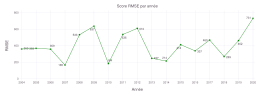

In [67]:
range_annee=sort(unique(dataset6.Année))[begin+5:end]

df = normalize_dataset(copy(dataset6))
y_normalisations = normalize_output(df)
range=sort(unique(df.Année))[begin+5:end]
cols=["Année"]
[push!(cols, "$(zone)") for zone in unique(df.Zone)]
resultats = DataFrame(ones(length(range), length(unique(df.Zone))+1), cols)
resultats.Année .= range
vraies_valeurs = DataFrame(ones(length(range), length(unique(df.Zone))+1), cols)
vraies_valeurs.Année .= range

rmse_par_année = []

for année_à_prédire in range
    train = df[df.Année .< année_à_prédire,  :]
    test  = df[df.Année .== année_à_prédire, :]

    y_train = train.Cerfs

    y_test = test.Cerfs;
    trained_models = train_models_by_zone(train, 1.0, zone_variables_to_drop_dict)
    ŷ      = predict_by_zone(test, trained_models)
    ŷ      = retrieve_output(ŷ, test.Zone, y_normalisations)
    ŷ[ŷ .< 0] .= 0
    y_test = retrieve_output(y_test, test.Zone, y_normalisations)
    i=1
    for zone in test.Zone
        resultats[resultats.Année .== année_à_prédire, "$(zone)"] .= ŷ[i]
        vraies_valeurs[resultats.Année .== année_à_prédire, "$(zone)"] .= y_test[i]
        i+=1
    end
    
    push!(rmse_par_année, rms(y_test, ŷ))
end

vraies_valeurs.Année .= range_annee
resultats.Année .= range_annee

println("RMSE moyen : $(mean(rmse_par_année))")
println("RMSE médian : $(median(rmse_par_année))")

set_default_plot_size(26cm, 10cm)
plot(x=range_annee[begin:end-1], y=rmse_par_année[begin:end-1], Geom.line, Geom.point, color=[colorant"green"],
    label=["$(Int64(ceil(rmse)))" for rmse in rmse_par_année[begin:end-1]],
    Geom.label,
    Guide.xlabel("Année"),
    Guide.xticks(ticks=range_annee[begin:end-1]),
    Guide.ylabel("RMSE"),
    Guide.title("Score RMSE par année"))

Nous avons entrainé un modèle par zone et par année. Ce modèle pour une année `A` et une zone `Z` prenait en données d'entrainement les données telle que `Année < A` et `Zone = Z`.

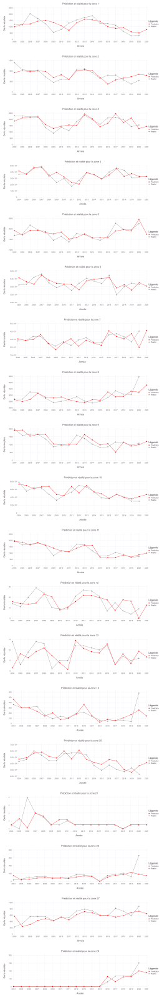

In [68]:
figs = []
for zone in unique(df.Zone)
    push!(figs,
        plot(x=range_annee, y=resultats[!, "$(zone)"], color=[colorant"red"], Geom.line, Geom.point,
            layer(x=range_annee[begin:end-1], y=vraies_valeurs[vraies_valeurs.Année .< range_annee[end], "$(zone)"], Geom.point, Geom.line, color=[colorant"grey"]),
            Guide.xlabel("Année"),
            Guide.ylabel("Cerfs récoltés"),
            Guide.title("Prédiction et réalité pour la zone $(zone)"),
            Guide.manual_color_key("Légende", ["Prédiction", "Réalité"], ["red", "grey"]),
            Guide.xticks(ticks=range_annee)
        )
    )
end
set_default_plot_size(26cm, 160cm)
vstack(figs...)

---
## 5. Estimation du nombre de cerfs mâles adultes récoltés par zone de chasse en 2021 

On utilise le dernier modèle de la section précédente entrainé sur toutes les années précédant 2021 pour estimer le nombre de cerfs récoltés pour chacune des lignes de l'ensemble de test.

### 5.1 Chargement des données de l'ensemble de test et définition des variables explicatives

In [69]:
test = CSV.read("data/test.csv", DataFrame);

### 5.2 Préparation du fichier des préditions pour téléverser sur Kaggle

Le fichier *benchmark_predictions.csv* généré peut être téléversé sur Kaggle. Il est composé d'une colonne de zones (Zone) et d'une colonne du nombre de cerfs récoltés (Cerfs).

In [70]:
ŷ=[]
[push!(ŷ, resultats[resultats.Année .== range_annee[end], "$(zone)"][1]) for zone in test.Zone]
prediction = DataFrame(Zone = test.Zone, Cerfs = ŷ)

CSV.write("output.csv", prediction)
prediction

,Zone,Cerfs
,Int64,Any
1,1,777.116
2,2,794.293
3,3,1448.58
4,4,3307.61
5,5,1744.35
6,6,4087.56
7,7,4152.86
8,8,3804.14
9,9,1202.59


## 6 Autres expérimentations faites

### 6.1 Variations du DataFrame d'entrée
Dans nos divers tests (principalement avec la méthode présentée précédemment mais également avec les méthodes présentées plus-bas qui ont donné de moins bons résultats), nous avons expérimentés plusieurs variations du dataframe d'entrée afin d'avoir le meilleur modèle possible.

Parmis les différentes variations, nous pouvons citer : 
- Ne pas utiliser la décomposition en sinus et cosinus de l'année
- Utiliser des fenêtres glissantes plus ou moins grande (donc regarder les données sur plus ou moins d'années en arrière)
- Utiliser des informations par semaines plutôt que par mois pour les prix de l'essence et les informations météorologiques
- Regarder les données météorologiques des années précédentes mais seulement sur certains mois
- Utiliser d'autres descriptions des données météorologiques comme la température maximale sur un mois
- Ne pas utiliser la prédiction du nombre total de cerfs récoltés

Ce qui a été présenté plus haut est ce qui nous a permis d'obtenir les meilleurs résultas sur l'ensemble de test (Kaggle), à l'exception d'une submission que nous n'avons pas réussi à reproduire.

### 6.2 Régression avec PCA

Nous effectuons une PCA pour modifier nos données dans le but de retirer les corrélations entre les variables

In [71]:
function PCA_train_models_by_zone(train::DataFrame, λ::Float64, zone_variables_to_drop_dict::Dict{Any, Any})
    models = DataFrame(Zone = Int64[], β̂=Vector{Float64}[], ȳ = Float64[], std = Float64[], variables_to_drop = Vector{String}[])  # On initialise le DataFrame vide
    
    for col in names(train)
        if typeof(eltype(train[:,col])) == Float64
            train[ismissing.(train[:,col]), col] .= mean(skipmissing(train[:, col]))
        elseif typeof(eltype(train[:,col])) == Int64
            train[ismissing.(train[:,col]), col] .= ceil(mean(skipmissing(train[:, col])))
        end
    end
    train = disallowmissing(train)
    
    zones = groupby(train, :Zone)  # On groupe les données par zone
    
    for zone in zones  # Pour chaque zone de chasse,
        variables_to_drop = zone_variables_to_drop_dict["$(zone.Zone[1])"]
        variables_to_drop_intersect = collect(intersect(Set(names(zone)), Set(variables_to_drop)))

        y = zone.Cerfs
        mean_y = mean(y)
        s_y = std(y)
        n = length(y)
        
        z = select(zone, Not(variables_to_drop_intersect))
        Z = Matrix(z)
        
        F = svd(Z)
        
        U = F.U
        V = F.V
        γ = F.S
        
        T = Z*V
        
        η̂ = T\y
        
        β̂ = V*η̂

        push!(models, [zone.Zone[1], β̂, mean_y, s_y, variables_to_drop])  # On ajoute cela au DataFame
    end
    
    return models
end

PCA_train_models_by_zone (generic function with 1 method)

In [72]:
df = normalize_dataset(copy(dataset6))
zone_variables_to_drop_dict = Dict()

k = 200

for zone in unique(df.Zone)
    zone_df = df[df.Zone .== zone, :]

    # On enleve les variables de toutes les zones identifiées comme non corrélées dans la partie 2.7
    variables_to_force_drop = []
    zone_corr = zone_correlees[zone]

    for name in names(zone_df)
        if occursin("zone_", name)
            drop = true
            for z in zone_corr
                if endswith(name, "zone_$(z)")
                    drop = false
                end
            end
            if drop == true
                push!(variables_to_force_drop, name)
            end
        end
    end

    variables_exclues = vcat(variables_to_force_drop, ["Cerfs", "Zone", "Année"])

    X = zone_df[:, Not(variables_exclues)]
    features = names(X)
    X = Matrix(X)
    y = zone_df.Cerfs

    variables_to_keep = select_k_features(X, features, y, k)

    push!(variables_to_keep, "Zone")
    push!(variables_to_keep, "Année")

    variables_to_drop = names(zone_df[1, Not(variables_to_keep)])

    println("Variables à garder pour la zone zone $(zone) : $(variables_to_keep)")
    println()

    zone_variables_to_drop_dict["$(zone)"] = variables_to_drop
end

Variables à garder pour la zone zone 1 : ["Cerfs_année_delta_1_zone_1", "Total", "Année_cos_1", "Année_cos_25", "Année_cos_23", "total_cerfs", "Année_sin_21", "Année_sin_3", "Total_permis_delta_1", "Cerfs_année_delta_1_zone_2", "Cerfs_année_delta_1_zone_11", "Cerfs_année_delta_2_zone_11", "Moyenne_Total Snow (cm)_m1", "Cerfs_année_delta_1_zone_10", "Cerfs_année_delta_3_zone_11", "Total_permis_delta_2", "Année_cos_22", "Année_cos_2", "Cerfs_année_delta_2_zone_10", "Min_Mean Temp (°C)_m5", "Cerfs_année_delta_2_zone_2", "Cerfs_année_delta_1_zone_12", "Cerfs_année_delta_1_zone_3", "Moyenne_Total Rain (mm)_m7", "Année_cos_4", "Année_cos_20", "Cerfs_année_delta_3_zone_10", "Cerfs_année_delta_2_zone_1", "Moyenne_Total Rain (mm)_m5", "Moyenne_Total Snow (cm)_m12", "Moyenne_Total Rain (mm)_m1", "Moyenne_Mean Temp (°C)_m8", "Moyenne_Snow on Grnd (cm)_m2", "Moyenne_Total Rain (mm)_m3", "Moyenne_Snow on Grnd (cm)_m12", "Cerfs_année_delta_3_zone_3", "Total_permis_delta_3", "Min_Mean Temp (°C)_m6", 

Variables à garder pour la zone zone 3 : ["total_cerfs", "Année_cos_2", "Année_cos_22", "Cerfs_année_delta_1_zone_2", "Cerfs_année_delta_1_zone_10", "Moyenne_Snow on Grnd (cm)_m2", "Cerfs_année_delta_2_zone_10", "Moyenne_Snow on Grnd (cm)_m1", "Cerfs_année_delta_1_zone_3", "Cerfs_année_delta_1_zone_1", "Cerfs_année_delta_3_zone_10", "Cerfs_année_delta_1_zone_11", "Cerfs_année_delta_2_zone_2", "Total", "Année_cos_4", "Année_cos_20", "Moyenne_neige_au_sol", "Moyenne_Mean Temp (°C)_m4", "Cerfs_année_delta_1_zone_9", "Cerfs_année_delta_3_zone_7", "Cerfs_année_delta_2_zone_11", "Moyenne_Total Snow (cm)_m2", "Moyenne_Total Snow (cm)_m1", "Min_Mean Temp (°C)_m3", "Moyenne_Total Rain (mm)_m7", "Moyenne_Mean Temp (°C)_m12", "Cerfs_année_delta_2_zone_9", "Moyenne_température", "Moyenne_Snow on Grnd (cm)_m12", "Cerfs_année_delta_3_zone_2", "Min_Snow on Grnd (cm)_m1", "Moyenne_Total Rain (mm)_m11", "Min_Mean Temp (°C)_m4", "Année_cos_11", "Année_cos_13", "Année_sin_7", "Année_sin_17", "Année_sin_2

Variables à garder pour la zone zone 7 : ["Année_sin_22", "Année_sin_2", "Moyenne_Snow on Grnd (cm)_m1", "Min_Mean Temp (°C)_m6", "Moyenne_Snow on Grnd (cm)_m2", "Moyenne_neige_au_sol", "Total", "Moyenne_Mean Temp (°C)_m7", "Moyenne_Total Rain (mm)_m7", "Moyenne_Snow on Grnd (cm)_m4", "total_cerfs", "Moyenne_Total Rain (mm)_m4", "Moyenne_Total Rain (mm)_m1", "Min_Mean Temp (°C)_m7", "Année_cos_2", "Année_cos_22", "Min_Mean Temp (°C)_m5", "Année_cos_13", "Année_cos_11", "Moyenne_Total Snow (cm)_m1", "Moyenne_Mean Temp (°C)_m4", "Année_cos_10", "Année_cos_14", "Moyenne_Total Rain (mm)_m10", "Cerfs_année_delta_1_zone_8", "Année_cos_12", "Moyenne_Total Snow (cm)_m11", "Min_Mean Temp (°C)_m4", "Min_Snow on Grnd (cm)_m1", "Total_permis_delta_1", "Moyenne_Snow on Grnd (cm)_m11", "Année_sin_12", "Cumul_pluie", "Moyenne_Total Rain (mm)_m9", "Moyenne_Total Rain (mm)_m8", "Moyenne_Snow on Grnd (cm)_m3", "Min_Snow on Grnd (cm)_m3", "Année_cos_1", "Année_cos_25", "Année_cos_23", "Année_sin_17", "An

Variables à garder pour la zone zone 10 : ["total_cerfs", "Cerfs_année_delta_1_zone_20", "Cerfs_année_delta_1_zone_10", "Cerfs_année_delta_2_zone_20", "Cerfs_année_delta_1_zone_11", "Cerfs_année_delta_1_zone_2", "Année_cos_22", "Année_cos_2", "Cerfs_année_delta_1_zone_9", "Cerfs_année_delta_3_zone_20", "Année_sin_1", "Année_sin_25", "Année_sin_23", "Cerfs_année_delta_2_zone_10", "Moyenne_Québec_essence", "Moyenne_Total Rain (mm)_m5", "Moyenne_Total Snow (cm)_m2", "Cerfs_année_delta_3_zone_3", "Année_cos_4", "Année_cos_20", "Année_sin_24", "Total", "Cerfs_année_delta_2_zone_11", "Cerfs_année_delta_2_zone_2", "Total_année_delta_1", "Cerfs_année_delta_2_zone_9", "Cerfs_année_delta_1_zone_6", "Cerfs_année_delta_3_zone_1", "Moyenne_Total Rain (mm)_m10", "Année_sin_2", "Année_sin_22", "Moyenne_Snow on Grnd (cm)_m2", "Cerfs_année_delta_3_zone_10", "Moyenne_Snow on Grnd (cm)_m1", "Année_cos_23", "Année_cos_25", "Année_cos_1", "Moyenne_Snow on Grnd (cm)_m4", "Moyenne_Total Rain (mm)_m3", "Moyen


Variables à garder pour la zone zone 20 : ["Cerfs_année_delta_1_zone_20", "Cerfs_année_delta_1_zone_7", "total_cerfs", "Cerfs_année_delta_1_zone_26", "Cerfs_année_delta_1_zone_10", "Cerfs_année_delta_2_zone_7", "Moyenne_Québec_essence", "Cerfs_année_delta_2_zone_20", "Année_sin_1", "Année_sin_25", "Année_sin_23", "Année_sin_2", "Année_sin_22", "Moyenne_Total Snow (cm)_m2", "Cerfs_année_delta_3_zone_20", "Cerfs_année_delta_2_zone_10", "Cerfs_année_delta_1_zone_11", "Cerfs_année_delta_3_zone_26", "Moyenne_Total Rain (mm)_m5", "Année_cos_23", "Année_cos_25", "Année_cos_1", "Cerfs_année_delta_3_zone_7", "Année_cos_4", "Année_cos_20", "Moyenne_Total Rain (mm)_m4", "Cerfs_année_delta_2_zone_26", "Cerfs_année_delta_2_zone_2", "Moyenne_Snow on Grnd (cm)_m2", "Cerfs_année_delta_2_zone_11", "Cerfs_année_delta_1_zone_9", "Cerfs_année_delta_1_zone_2", "Année_sin_24", "Min_Mean Temp (°C)_m7", "Moyenne_Snow on Grnd (cm)_m4", "Total", "Cerfs_année_delta_2_zone_9", "Cerfs_année_delta_3_zone_6", "Cerf

Variables à garder pour la zone zone 27 : ["Année_sin_23", "Année_sin_1", "Année_sin_25", "Cerfs_année_delta_1_zone_26", "Cerfs_année_delta_1_zone_8", "Année_cos_10", "Année_cos_14", "Moyenne_Total Rain (mm)_m1", "Année_cos_20", "Année_cos_4", "Moyenne_Mean Temp (°C)_m1", "Cerfs_année_delta_2_zone_5", "Cerfs_année_delta_3_zone_5", "Total_année_delta_1", "Année_sin_20", "Année_sin_4", "Min_Mean Temp (°C)_m9", "Total_année_delta_3", "Cerfs_année_delta_3_zone_26", "Cerfs_année_delta_3_zone_8", "Moyenne_Mean Temp (°C)_m7", "Moyenne_Mean Temp (°C)_m4", "Min_Mean Temp (°C)_m7", "Moyenne_Total Snow (cm)_m11", "Cerfs_année_delta_1_zone_5", "Moyenne_Total Snow (cm)_m3", "Année_cos_9", "Année_cos_15", "Année_sin_17", "Année_sin_7", "Moyenne_Total Rain (mm)_m11", "Total_année_delta_2", "Moyenne_Total Rain (mm)_m2", "Cerfs_année_delta_2_zone_8", "Min_Mean Temp (°C)_m1", "total_cerfs", "Année_cos_13", "Année_cos_11", "Année_cos_12", "Année_cos_7", "Année_cos_17", "Min_Mean Temp (°C)_m6", "Année_sin

RMSE moyen : 670.139283215245
RMSE médian : 556.7142296847283


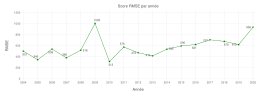

In [73]:
range_annee=sort(unique(dataset6.Année))[begin+5:end]

df = normalize_dataset(copy(dataset6))
y_normalisations = normalize_output(df)
range=sort(unique(df.Année))[begin+5:end]
cols=["Année"]
[push!(cols, "$(zone)") for zone in unique(df.Zone)]
resultats = DataFrame(ones(length(range), length(unique(df.Zone))+1), cols)
resultats.Année .= range
vraies_valeurs = DataFrame(ones(length(range), length(unique(df.Zone))+1), cols)
vraies_valeurs.Année .= range

rmse_par_année = []

for année_à_prédire in range
    train = df[df.Année .< année_à_prédire,  :]
    test  = df[df.Année .== année_à_prédire, :]

    y_train = train.Cerfs

    y_test = test.Cerfs;
    trained_models = PCA_train_models_by_zone(train, .1, zone_variables_to_drop_dict)
    ŷ      = predict_by_zone(test, trained_models)
    ŷ      = retrieve_output(ŷ, test.Zone, y_normalisations)
    y_test = retrieve_output(y_test, test.Zone, y_normalisations)
    i=1
    for zone in test.Zone
        resultats[resultats.Année .== année_à_prédire, "$(zone)"] .= ŷ[i]
        vraies_valeurs[resultats.Année .== année_à_prédire, "$(zone)"] .= y_test[i]
        i+=1
    end
    
    push!(rmse_par_année, rms(y_test, ŷ))
end

vraies_valeurs.Année .= range_annee
resultats.Année .= range_annee

println("RMSE moyen : $(mean(rmse_par_année))")
println("RMSE médian : $(median(rmse_par_année))")

set_default_plot_size(26cm, 10cm)
plot(x=range_annee[begin:end-1], y=rmse_par_année[begin:end-1], Geom.line, Geom.point, color=[colorant"green"],
    label=["$(Int64(ceil(rmse)))" for rmse in rmse_par_année[begin:end-1]],
    Geom.label,
    Guide.xlabel("Année"),
    Guide.xticks(ticks=range_annee[begin:end-1]),
    Guide.ylabel("RMSE"),
    Guide.title("Score RMSE par année"))

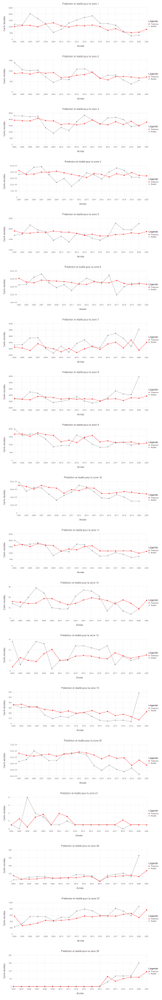

In [74]:
figs = []
for zone in unique(df.Zone)
    push!(figs,
        plot(x=range_annee, y=resultats[!, "$(zone)"], color=[colorant"red"], Geom.line, Geom.point,
            layer(x=range_annee[begin:end-1], y=vraies_valeurs[vraies_valeurs.Année .< range_annee[end], "$(zone)"], Geom.point, Geom.line, color=[colorant"grey"]),
            Guide.xlabel("Année"),
            Guide.ylabel("Cerfs récoltés"),
            Guide.title("Prédiction et réalité pour la zone $(zone)"),
            Guide.manual_color_key("Légende", ["Prédiction", "Réalité"], ["red", "grey"]),
            Guide.xticks(ticks=range_annee)
        )
    )
end
set_default_plot_size(26cm, 160cm)
vstack(figs...)

Nous observons que nos prédictions sont beaucoup plus lissées. Il est probable que les variables créées par la PCA soient beaucoup moins corrélées avec notre target `Cerfs`, donc les prédictions sont plus proches de la moyenne pour chaque zone.

### 6.3 Prédiction à partir d'un seul modèle et non d'un modèle par zone

Afin de bénéficier de plus de données d'entrainement, nous avons essayé d'entrainer un seul model commun à toutes les zones. Cela nécessite un encodage one hot des zones à ajouter en tant que variables explicatives. Nous allons utiliser toutes les données antérieures à 2020 et estimer la validité du modèle sur l'année 2020.

In [77]:
df = copy(dataset6)
df_train = df[df.Année.<2020 .&& df.Zone.!=21,:] # on va également enlever la zone 21 car absente de l'année 2020
df_val = df[df.Année.==2020,:]
M = select(df_train, [:Zone => ByRow(isequal(v))=> Symbol(v) for v in unique(df_train.Zone)]);
M2 = select(df_val, [:Zone => ByRow(isequal(v))=> Symbol(v) for v in unique(df_val.Zone)]);
df2 = hcat(df_train, M);
df3 = hcat(df_val, M2);

X_train = Matrix(select(df2, Not(["Zone","Cerfs"]))); # en raison de l'encodage one-hot, on n'a pas besoin d'une colonne remplie de 1
# X_train = Matrix(M) # décommenter cette ligne pour voir un modèle qui prend uniquement les encodages one-hot
y_train = df2.Cerfs;
X_val = Matrix(select(df3, Not(["Zone","Cerfs"])));
# X_val = Matrix(M2) # décommenter cette ligne pour voir un modèle qui prend uniquement les encodages one-hot
y_val = df3.Cerfs;

β̂ = X_train\y_train;
e = y_train - X_train*β̂
SSE = e'e
println("SSE sur les données d'entrainement: ", SSE)

y_pred = X_val*β̂
RMSE = rms(y_val, y_pred)
println("RMSE sur l'année de validation 2020: ", RMSE)

SSE sur les données d'entrainement: 6.6033308986616164e7
RMSE sur l'année de validation 2020: 698.6734677044846


On remarque déjà que le RMSE sur les données de validation est élevé, ce qui laisse penser qu'un modèle général plutôt qu'un modèle par zone est une mauvaise idée.  Les variables explicatives ont donc des influences différentes selon la zone. Considérer les coefficients de régressions égaux pour toutes les zones impacte négativement nos résultats. Ce modèle est cependant toujours meilleur qu'un modèle prenant uniquement l'encodage one-hot des zones (qui a un RMSE de 1064.2 en validation).

### 6.4 Création de modèles avec un nombre limité de variables
#### 6.4.1 Analyse approfondie d'un modèle pour une zone donnée

Nous allons ici chercher à construire le meilleur modèle possible pour la zone 2 uniquement. Ceci pourrait nous donner une idée des variables à utiliser par la suite. Attention tout de même, nous avons constaté en répétant le procédé avec différentes zones que les résultats changaient considérablement.

In [78]:
# Un corr_threshold <= 0 signifie que l'on ne retire pas de variables
# Je remets ici la fonction que j'utilisais de mon côté car utiliser celle plus optimisée donne d'autres résultats
function retirer_variables_correlees_zone(df, zone, corr_threshold)
    df_corr = get_correlation_matrix(remove_null_variance_columns(df[df.Zone .== zone, :]))
    variables_to_drop = []
    variables_to_keep = ["Année", "Cerfs", "Zone"]
    for name in names(df_corr)
        if name != "index"
            df_corr[:, name] .= abs.(df_corr[:, name])
        end
    end
    for i in 1:size(df_corr)[1]
       for j in i+1:size(df_corr)[1]
            if !(df_corr[i, :index]=="Cerfs" || df_corr[j, :index]=="Cerfs")
                if df_corr[i, j] > corr_threshold
                    if df_corr[i, "Cerfs"] < df_corr[j, "Cerfs"] # on supprime la variable avec la plus faible corrélation avec cerfs
                        if !(df_corr[i, :index] in variables_to_keep) && !(df_corr[i, :index] in variables_to_drop)
                            push!(variables_to_drop, df_corr[i, :index])
                        end
                    else
                        if !(df_corr[j, :index] in variables_to_keep) && !(df_corr[j, :index] in variables_to_drop)
                            push!(variables_to_drop, df_corr[j, :index])
                        end
                    end
                end
            end
        end
    end
    return variables_to_drop
end;

In [88]:
zone = 2
df = remove_null_variance_columns(dataset6[dataset6.Zone .== zone, :])
df_train = df[df.Année.<2020,:] 
df_val = df[df.Année.==2020,:]
y_train = df_train.Cerfs;
y_val = df_val.Cerfs;
n = length(y_train)

z = fill(zone, n)
temp = DataFrame(Zone=z);
df_train = hcat(temp,df_train)
z = fill(zone, 1)
temp = DataFrame(Zone=z);
df_val = hcat(temp,df_val)
variables_a_enlever = ["Zone","Cerfs"]
[push!(variables_a_enlever, v) for v in retirer_variables_correlees_zone(df_train, zone, 0.42)]

X_train = hcat(ones(n), Matrix(select(df_train, Not(variables_a_enlever)))); 
X_val = hcat(ones(1),Matrix(select(df_val, Not(variables_a_enlever))));

In [89]:
β̂ = X_train\y_train;
e = y_train - X_train*β̂
SSE = e'e
println("SSE sur les données d'entrainement: ",SSE)
p = size(X_train, 2) #prend déjà en compte la colonne remplie de zéros
σ̂² = SSE / (n-p)

y_pred = X_val*β̂
RMSE = rms(y_val, y_pred)
println("RMSE sur l'année de validation 2020: ",RMSE)

SSE sur les données d'entrainement: 287102.49245547416
RMSE sur l'année de validation 2020: 38.76507610701924


On peut procéder à une analyse des coefficients de régression pour savoir quelles variables choisies semblent avoir un effet significatif. Pour ce faire, on construit un interval de confiance autour des betas grâce aux quartiles de la loi de Student. Si 0 se trouve dans l'intervalle, on ne peut pas rejeter l'hypothèse que le coefficient devrait être nul.

In [90]:
# Niveau de confiance
α = .05
v = diag(inv(X_train'X_train))
# Calcul du quantile d'ordre (1-α/2) de la loi de Student à (n-p) degrés de liberté
q = quantile(TDist(n-p), 1-α/2)
# Intervalles de confiance à 95%
se = q * sqrt.(σ̂² * v)
a = round.(β̂ - se, digits=3)
b = round.(β̂ + se, digits=3)

vars = ["intercept"]
[push!(vars, v) for v in names(select(df_train, Not(variables_a_enlever)))]
p = length(vars)
for i in 1:p
    print("β ",vars[i]," = ", β̂[i]," [",a[i]," ",b[i],"]")
    if (a[i]<0 && b[i]>0)
        print("  xxx Beta non significatif xxx")
    end
    print("\n")
end

β intercept = 7567.432336047354 [-23387.349 38522.214]  xxx Beta non significatif xxx
β Année = -4.212476884556818 [-19.368 10.943]  xxx Beta non significatif xxx
β Cerfs_année_delta_3_zone_28 = 6.092496831401772 [-6.852 19.037]  xxx Beta non significatif xxx
β Année_sin_7 = 35.513734527212975 [-81.742 152.77]  xxx Beta non significatif xxx
β Année_sin_8 = -4.0537555745377105 [-119.056 110.949]  xxx Beta non significatif xxx
β Année_sin_11 = 45.91590978362643 [-54.293 146.125]  xxx Beta non significatif xxx
β Année_cos_6 = 25.30928677904717 [-82.945 133.563]  xxx Beta non significatif xxx
β Année_cos_10 = 73.1070050882019 [-38.538 184.752]  xxx Beta non significatif xxx
β total_cerfs = 0.041402886416282036 [0.021 0.062]


En analysant les β, on se rend compte que la plupart sont non significatifs. Ceci est dû au très faible nombre de données d'entraînement ou aux possibles multicolinéarités (on enlève uniquement les variables très corrélées 2 à 2) qui rendent ces valeurs β très instables. Ainsi, l'erreur de validation assez faible laisse penser qu'on peut utiliser ce modèle pour faire de la prédiction, mais on ne pourra pas utiliser l'information sur la significativité des β pour réduire le nombre de variables explicatives. Aussi, faire le test de student demande d'inverser la matrice X alors, ce qui pourrait faire planter Julia si la matrice est non inversible.

#### 6.4.2 Construction ascendante d'un modèle avec sélection de features pas à pas pour une seule zone

In [91]:
function init_datas(df, zone, annee, corr_treshold)
    df2 = copy(df)
    df2 = remove_null_variance_columns(df[df.Zone .== zone, :])
    df_train = df2[df2.Année.<annee,:] 
    df_val = df2[df2.Année.==annee,:]
    y_train = df_train.Cerfs;
    y_val = df_val.Cerfs;
    n = length(y_train)
    
    z = fill(zone, n)
    temp = DataFrame(Zone=z); # il faut remettre la colonne Zone qui a été enlevée car variance nulle. Elle est nécessaire dans retirer_variables_correlees_zone 
    df_train = hcat(temp,df_train)
    z = fill(zone, 1)
    temp = DataFrame(Zone=z)
    df_val = hcat(temp,df_val)
    variables_a_enlever = ["Zone","Cerfs"]
    [push!(variables_a_enlever, v) for v in retirer_variables_correlees_zone(df_train, zone, corr_treshold)]
    df_train = select(df_train, Not(variables_a_enlever))
    df_val = select(df_val, Not(variables_a_enlever))
    return df_train, y_train, df_val, y_val
end

function get_Rsquared_adj(X, y)
    β̂ = X\y;
    e = y - X*β̂
    SSE = e'e
    SST = sum( (y .- mean(y)).^2)
    n = size(X,1)
    p = size(X,2) # prend en compte l'éventuelle colonne remplie de 1
    return 1 - (SSE/(n-p))/(SST/(n-1))
end;

function best_model_for_zone(df, y, zone, features, max_features)
    n = size(df,1)
    features_considerees = []
    Rsq_aj_precedent = -1000
    for i in 1:max_features
        Rsq_aj_max = -1000
        idx_max = 1
        for j in 1:length(features)
            if !(features[j] in features_considerees)
                features_temp = copy(features_considerees)
                push!(features_temp, features[j])
                X =  hcat(ones(n), Matrix(select(df, features_temp)))
                Rsq_aj = get_Rsquared_adj(X,y)
                if Rsq_aj > 1.8*Rsq_aj_max
                    Rsq_aj_max = Rsq_aj
                    idx_max = j
                end
            end
        end
        if Rsq_aj_max > Rsq_aj_precedent # on n'ajoute la variable que si ça donne un gain en terme de R²ajusté
            push!(features_considerees, features[idx_max])
            Rsq_aj_precedent = Rsq_aj_max
        else
            return features_considerees
        end 
    end
    return features_considerees
end;

In [113]:
zone = 2
df_train, y_train, df_val, y_val = init_datas(dataset6, zone, 2020, 0.8);
features = names(df_train);
features_considerees = best_model_for_zone(df_train, y_train, zone, features, 5);

In [114]:
n = size(df_train,1)
X_train = hcat(ones(n), Matrix(select(df_train, features_considerees))); 
p = size(X_train,2)
X_val = hcat(ones(1),Matrix(select(df_val, features_considerees)));
β̂ = X_train\y_train;
e = y_train - X_train*β̂
SSE = e'e
println("SSE sur les données d'entrainement: ",SSE)
p = size(X_train, 2) #prend déjà en compte la colonne remplie de zéros
σ̂² = SSE / (n-p)

y_pred = X_val*β̂
RMSE = rms(y_val, y_pred)
println("Erreur sur l'année de validation 2020: ",RMSE)

SSE sur les données d'entrainement: 395060.2968743023
Erreur sur l'année de validation 2020: 98.03440186906664


L'erreur obtenue à l'année 2020 sur la zone 2 est très faible, ça semble être un bon modèle. Attention cependant, le SSE est plutôt élevé (le modèle ne fit pas si bien les données d'entraînement qu'on pourrait l'espérer), cette erreur faible n'est peut être qu'un coup de chance.

In [115]:
# Niveau de confiance
α = .05
v = diag(inv(X_train'X_train))
# Calcul du quantile d'ordre (1-α/2) de la loi de Student à (n-p) degrés de liberté
q = quantile(TDist(n-p), 1-α/2)
# Intervalles de confiance à 95%
se = q * sqrt.(σ̂² * v)
a = round.(β̂ - se, digits=3)
b = round.(β̂ + se, digits=3)

vars = ["intercept"]
[push!(vars, v) for v in names(select(df_train, features_considerees))]
p = length(vars)
for i in 1:p
    print("β ",vars[i]," = ", β̂[i]," [",a[i]," ",b[i],"]")
    if (a[i]<0 && b[i]>0)
        print("  xxx Beta non significatif xxx")
    end
    print("\n")
end

β intercept = 12796.71518893209 [-14072.716 39666.146]  xxx Beta non significatif xxx
β total_cerfs = 0.04023951222700297 [0.024 0.057]
β Année = -6.605167392277547 [-19.832 6.622]  xxx Beta non significatif xxx


Nous remarquons encore une fois que la plupart des coefficients de régressions ne sont pas forcément significatifs, pour la même raison qu'expliquée plus haut. Aussi, nous remarquons que seules trois fetaures ont été sélectinnées. En effet, apèrs avoir sélectionné l'année et la prédiction sur le nombre de cerfs récoltés dans l'ensmble des zones, plus aucune variable ne permettait d'améliorer le R²ajusté.

Enfin, la prédiction sur le nombre total de cerfs récoltés semble s'avérer utile puisque cette variable a été sélectionnée et possède un coefficient significatif.

#### 6.4.3 Construction des modèles en mode pas à pas ascendant sur toutes les zones

In [116]:
zones = unique(dataset6.Zone);
models = Dict()
preds = Dict()
for z in zones
    if z == 21 || z == 28
        continue
    end
    df_train, y_train, df_val, y_val = init_datas(dataset5, z, 2020, 0.6);
    features = names(df_train);
    features_considerees = best_model_for_zone(df_train, y_train, z, features, 4 );
    n = size(df_train,1)
    X_train = hcat(ones(n), Matrix(select(df_train, features_considerees))); 
    p = size(X_train,2) # prend en compte la colonne remplie de 1
    X_val = hcat(ones(1),Matrix(select(df_val, features_considerees)));
    # regression en considérant le nombre de features max
    β̂ = X_train\y_train;
    models[z] = [β̂ ,features_considerees]
    e = y_train - X_train*β̂
    SSE = e'e
    println("Zone ",z," - SSE sur les données d'entrainement: ",SSE)
    σ̂² = SSE / (n-p)
    y_pred =  X_val*β̂
    y_pred =  max(0, y_pred[1]) # on se permet d'ajouter une fonction max par dessus la régression car on sait que les valeurs sont positives
    preds[z] = y_pred
    RMSE = rms([y_val[1]], [y_pred])
    println("Zone ",z," - RMSE sur l'année de validation 2020: ",RMSE)
end

Zone 1 - SSE sur les données d'entrainement: 1.0060951605159193e6
Zone 1 - RMSE sur l'année de validation 2020: 394.7152842333453
Zone 2 - SSE sur les données d'entrainement: 395060.2968743023
Zone 2 - RMSE sur l'année de validation 2020: 98.03440186906664
Zone 3 - SSE sur les données d'entrainement: 916335.8635001611
Zone 3 - RMSE sur l'année de validation 2020: 114.35393150588061
Zone 4 - SSE sur les données d'entrainement: 6.568993673358332e6
Zone 4 - RMSE sur l'année de validation 2020: 1075.1325537714338
Zone 5 - SSE sur les données d'entrainement: 444456.56384509953
Zone 5 - RMSE sur l'année de validation 2020: 469.2122724342821
Zone 6 - SSE sur les données d'entrainement: 5.854574601403529e6
Zone 6 - RMSE sur l'année de validation 2020: 5.361619966624858
Zone 7 - SSE sur les données d'entrainement: 5.062155591311267e6
Zone 7 - RMSE sur l'année de validation 2020: 1082.222165274004
Zone 8 - SSE sur les données d'entrainement: 1.0019002400854761e6
Zone 8 - RMSE sur l'année de vali

Comme nous manquions de données sur les zones 21 et 28 pour l'année 2020, nous n'avons pas fait de regression sur ces zones. La prédiction sera la moyenne des récoltes dans lesdites zones

In [117]:
preds2 = Float64[]
zones = dataset5[dataset5.Année.==2020,:Zone]
y_reels = dataset5[dataset5.Année.==2020,:Cerfs]
for z in zones
    if z in keys(preds)
       push!(preds2, preds[z][1]) 
    else
        push!(preds2, mean(dataset5[dataset5.Zone.==z,:Cerfs]))
    end
end
println("rms:",rms(preds2, y_reels))
prediction = DataFrame(Zone = test.Zone, Cerfs = preds2)

CSV.write("output_min_rsq_jusqua_2019.csv", prediction)
prediction; # enlver le ; pour afficher les prédictions

rms:674.235063292689


Le RMSE de validation est relativement décevant, bien que meilleur que le RMSE du benchmark sur l'année 2021. Pour prédire les réclotes de cerfs de 2021, nous pouvons ensuite soit utiliser les modèles enregistrés dans la variable 'models' et entrainés sur les années <= 2019 (ce sont les modèles que nous venons de valider sur 2020), soit réutiliser la même méthode mais en entrainant les données en prenant également en compte l'année 2020. 

Avec le dernier dataset sur lequel nous avons travaillé, la première méthode (cellule du dessus) donne un RMSE sur l'ensemble de test d'environ 700 et la seconde (cellulle du dessous) donne un RMSE d'environ 800.

In [118]:
zones = unique(dataset6.Zone);
models = Dict()
preds = Dict()
for z in zones
    if z == 21 || z == 28
        continue
    end
    df_train, y_train, df_val, y_val = init_datas(dataset6, z, 2021, 0.6);
    features = names(df_train);
    features_considerees = best_model_for_zone(df_train, y_train, z, features, 4 );
    n = size(df_train,1)
    X_train = hcat(ones(n), Matrix(select(df_train, features_considerees))); 
    p = size(X_train,2) # prend en compte la colonne remplie de 1
    X_val = hcat(ones(1),Matrix(select(df_val, features_considerees)));
    # regression en considérant le nombre de features max
    β̂ = X_train\y_train;
    models[z] = [β̂ ,features_considerees]
    e = y_train - X_train*β̂
    SSE = e'e
    println("Zone ",z," - SSE sur les données d'entrainement: ",SSE)
    y_pred =  X_val*β̂
    y_pred =  max(0, y_pred[1]) # on se permet d'ajouter une fonction max par dessus la régression car on sait que les valeurs sont positives
    preds[z] = y_pred
end

Zone 1 - SSE sur les données d'entrainement: 2.0929095371240878e6
Zone 2 - SSE sur les données d'entrainement: 403016.31997114624
Zone 3 - SSE sur les données d'entrainement: 872146.4350203422
Zone 4 - SSE sur les données d'entrainement: 1.1974418417274544e7
Zone 5 - SSE sur les données d'entrainement: 396833.46356625995
Zone 6 - SSE sur les données d'entrainement: 5.854601371428366e6
Zone 7 - SSE sur les données d'entrainement: 8.736054414455082e6
Zone 8 - SSE sur les données d'entrainement: 2.6263230471331696e6
Zone 9 - SSE sur les données d'entrainement: 463088.6517205499
Zone 10 - SSE sur les données d'entrainement: 2.6376524408808418e7
Zone 11 - SSE sur les données d'entrainement: 834148.468417531
Zone 12 - SSE sur les données d'entrainement: 405.53280082681243
Zone 13 - SSE sur les données d'entrainement: 268.93791030806176
Zone 15 - SSE sur les données d'entrainement: 205448.28015336348
Zone 20 - SSE sur les données d'entrainement: 8.445832817316614e6
Zone 26 - SSE sur les donné

In [119]:
preds2 = Float64[]
zones = dataset6[dataset6.Année.==2021,:Zone]
for z in zones
    if z in keys(preds)
       push!(preds2, preds[z][1]) 
    else
        push!(preds2, mean(dataset6[dataset6.Zone.==z,:Cerfs]))
    end
end
prediction = DataFrame(Zone = test.Zone, Cerfs = preds2)

CSV.write("output_min_rsq_toutes_annees.csv", prediction)
prediction; # enlver le ; pour afficher les prédictions

#### 6.4.5 Construction de modèles en méthode ascendante mais optimisant le RMSE de valivation
Nous avons précédemment construit nos modèles avec la méthode ascedante en maximisant le R²ajusté. Nous avons aussi essayer de reproduire cette méthode en minimisant l'erreur sur un ensemble de validation (l'année 2020)

In [120]:
function get_validation_error(X_train, y_train, X_val, y_val)
    β̂ = X_train\y_train;
    yhat = X_val*β̂ 
    yhat =  max(0, yhat[1])
    return abs(yhat-y_val[1])
end;

function best_model_for_zone_with_validation(df_train, y_train, df_val, y_val, zone, features, max_features)
    n = size(df_train,1)
    features_considerees = []
    erreur_precedente = 100000
    for i in 1:max_features
        erreur_min = 100000
        idx_min = 1
        for j in 1:length(features)
            if !(features[j] in features_considerees)
                features_temp = copy(features_considerees)
                push!(features_temp, features[j])
                X_train =  hcat(ones(n), Matrix(select(df_train, features_temp)))
                X_val =  hcat(ones(1), Matrix(select(df_val, features_temp)))
                err = get_validation_error(X_train, y_train, X_val, y_val)
                if err < erreur_min
                    erreur_min = err
                    idx_min = j
                end
            end
        end
        if erreur_min < erreur_precedente # on n'ajoute la variable que si ça donne un gain en terme de minimisation d'erreur
            push!(features_considerees, features[idx_min])
            #println(features[idx_min])
            erreur_precedente = erreur_min
        else
            return features_considerees
        end 
    end
    return features_considerees
end;

In [121]:
zones = unique(dataset6.Zone);
models = Dict()
preds = Dict()
for z in zones
    if z == 21 || z == 28
        continue
    end
    df_train, y_train, df_val, y_val = init_datas(dataset5, z, 2020, 0.8);
    features = names(df_train);
    features_considerees = best_model_for_zone_with_validation(df_train, y_train, df_val, y_val, z, features, 5)
    n = size(df_train,1)
    X_train = hcat(ones(n), Matrix(select(df_train, features_considerees))); 
    p = size(X_train,2) # prend en compte la colonne remplie de 1
    X_val = hcat(ones(1),Matrix(select(df_val, features_considerees)));
    # regression en considérant le nombre de features max
    β̂ = X_train\y_train;
    models[z] = [β̂ ,features_considerees]
    e = y_train - X_train*β̂
    SSE = e'e
    println("Zone ",z," - SSE sur les données d'entrainement: ",SSE)
    σ̂² = SSE / (n-p)
    y_pred =  X_val*β̂
    y_pred =  max(0, y_pred[1]) # on se permet d'ajouter une fonction max par dessus la régression car on sait que les valeurs sont positives
    preds[z] = y_pred
    RMSE = rms([y_val[1]], [y_pred])
    println("Zone ",z," - RMSE sur l'année de validation 2020: ",RMSE)
end

Zone 1 - SSE sur les données d'entrainement: 2.257820567231532e6
Zone 1 - RMSE sur l'année de validation 2020: 0.06241653866214847
Zone 2 - SSE sur les données d'entrainement: 1.0691564479410425e6
Zone 2 - RMSE sur l'année de validation 2020: 0.13748714564974307
Zone 3 - SSE sur les données d'entrainement: 3.257217555866201e6
Zone 3 - RMSE sur l'année de validation 2020: 0.8019764173202475
Zone 4 - SSE sur les données d'entrainement: 1.5577231426511167e7
Zone 4 - RMSE sur l'année de validation 2020: 0.3624385211196568
Zone 5 - SSE sur les données d'entrainement: 683697.8099076604
Zone 5 - RMSE sur l'année de validation 2020: 0.007119086166767374
Zone 6 - SSE sur les données d'entrainement: 7.70217920285058e6
Zone 6 - RMSE sur l'année de validation 2020: 1.283785450645155
Zone 7 - SSE sur les données d'entrainement: 6.907553144143739e6
Zone 7 - RMSE sur l'année de validation 2020: 0.474958352196154
Zone 8 - SSE sur les données d'entrainement: 677867.5790078278
Zone 8 - RMSE sur l'année 

In [122]:
preds2 = Float64[]
zones = dataset6[dataset6.Année.==2020,:Zone]
y_reels = dataset6[dataset6.Année.==2020,:Cerfs]
for z in zones
    if z in keys(preds)
       push!(preds2, preds[z][1]) 
    else
        push!(preds2, mean(dataset6[dataset6.Zone.==z,:Cerfs]))
    end
end
rms(preds2, y_reels)

50.388928764053716

L'erreur sur l'ensemble de validation est très faible, ce qui est normal puisqu'on a cherché à la minimiser. Cependant, ce n'est pas pour autant que les résultats sur l'ensemble de test (année 2021) seront bons. En effet, les ensembles de test et de validation sont tellement petits (une seule donnée à prédire par zone) qu'on peut difficilement les considérer comme semblables.

In [123]:
df_test = dataset6[dataset6.Année.==2021,:]
zones = dataset6[dataset6.Année.==2021,:Zone]
preds3 = Float64[]
for z in zones
    if z in keys(models)
        df_temp = df_test[df_test.Zone.==z,:]
        beta = models[z][1]
        variables_considerees = models[z][2]
        X_test = hcat(ones(1), Matrix(select(df_temp, variables_considerees)));
        pred = (X_test*beta)[1]
        push!(preds3, pred) 
    else
        push!(preds3, mean(dataset6[dataset6.Zone.==z,:Cerfs]))
    end
end
prediction = DataFrame(Zone = test.Zone, Cerfs = preds3)

CSV.write("output_min_error_val.csv", prediction)
prediction; # enlever le ; pour voir les prédictions

Cette méthode donne un RMSE sur l'ensemble de test d'environ 700, ce qui est encore une fois trop élevé.

#### 6.4.6 Minimisation des r² ajustés mais avec regression ridge

In [124]:
function get_Rsquared_adj_Ridge(X, y, λ)
    β̂ = (X'*X + λ*I) \ (X' * y);
    e = y - X*β̂
    SSE = e'e
    SST = sum( (y .- mean(y)).^2)
    n = size(X,1)
    p = size(X,2) # prend en compte l'éventuelle colonne remplie de 1
    return 1 - (SSE/(n-p))/(SST/(n-1))
end;

function best_model_for_zone_Ridge(df, y, zone, features, max_features, λ )
    n = size(df,1)
    features_considerees = []
    Rsq_aj_precedent = -1000
    for i in 1:max_features
        Rsq_aj_max = -1000
        idx_max = 1
        for j in 1:length(features)
            if !(features[j] in features_considerees)
                features_temp = copy(features_considerees)
                push!(features_temp, features[j])
                X =  Matrix(select(df, features_temp))
                Rsq_aj = get_Rsquared_adj_Ridge(X,y, λ)
                if Rsq_aj > 1.8*Rsq_aj_max
                    Rsq_aj_max = Rsq_aj
                    idx_max = j
                end
            end
        end
        if Rsq_aj_max > Rsq_aj_precedent # on n'ajoute la variable que si ça donne un gain en terme de R²ajusté
            push!(features_considerees, features[idx_max])
            Rsq_aj_precedent = Rsq_aj_max
        else
            return features_considerees
        end 
    end
    return features_considerees
end;

function normalize_y(y, y_normalisations, zone)
    filter = y_normalisations[y_normalisations.Zone .== zone, :]
    return (y.-filter[1, :ȳ])./filter[1, :ȳ]
end;

function unnormalize_y(y, y_normalisations, zone)
    result = Float64[]
    filter = y_normalisations[y_normalisations.Zone .== zone, :]
    return (y.* filter[1, :std]) .+ filter[1, :ȳ]
end;

In [125]:
zones = unique(dataset6.Zone);
models = Dict()
preds = Dict()
y_normalisations = normalize_output(dataset6[dataset6.Année.<2020, :])
df_temp = normalize_dataset(copy(dataset6[dataset6.Année.<2020, :]));
first(df_temp, 5)

,Zone,Année,Cerfs,Moyenne_température,Cumul_neige,Cumul_pluie,Moyenne_neige_au_sol
,Int64,Float64,Int64,Float64,Float64,Float64,Float64
1,1,-1.45269,732,0.737283,0.122607,-1.295,2.8383
2,1,-1.28238,718,0.120929,-0.175936,-1.08213,-0.944749
3,1,-1.11208,879,-1.35592,-0.537806,0.125354,-0.395458
4,1,-0.941782,1196,-1.60315,-1.26004,-0.477847,-0.45996
5,1,-0.77148,1137,0.00411603,-0.430752,0.503755,-0.299031


In [126]:
zones = unique(dataset6.Zone);
models = Dict()
preds = Dict()
y_normalisations = normalize_output(dataset6[dataset6.Année.<=2020, :])
df_temp = normalize_dataset(copy(dataset6[dataset6.Année.<=2020, :]))
λ = 4
for z in zones
    if z == 21 || z == 28
        continue
    end
    df_train, y_train, df_val, y_val = init_datas(df_temp, z, max(df_temp.Année...), 0.9);
    features = names(df_train)
    y_train = normalize_y(y_train, y_normalisations, z)
    y_val_saves = copy(y_val)
    y_val = normalize_y(y_val, y_normalisations, z)
    features_considerees = best_model_for_zone_Ridge(df_train, y_train, z, features, 8, λ )
    n = size(df_train,1)
    X_train = hcat(ones(n), Matrix(select(df_train, features_considerees))); 
    p = size(X_train,2) # prend en compte la colonne remplie de 1
    X_val = hcat(ones(1),Matrix(select(df_val, features_considerees)));
    # regression en considérant le nombre de features max
    β̂ = (X_train'*X_train + λ*I) \ (X_train' * y_train);
    models[z] = [β̂ ,features_considerees]
    e = y_train - X_train*β̂
    SSE = e'e
    println("Zone ",z," - SSE sur les données d'entrainement: ",SSE)
    σ̂² = SSE / (n-p)
    y_pred =  X_val*β̂
    y_pred = unnormalize_y(y_pred, y_normalisations, z)
    y_pred =  max(0, y_pred[1]) # on se permet d'ajouter une fonction max par dessus la régression car on sait que les valeurs sont positives
    preds[z] = y_pred
    RMSE = rms([y_val_saves[1]], [y_pred])
    println("Zone ",z," - RMSE sur l'année de validation 2020: ",RMSE)
end

Zone 1 - SSE sur les données d'entrainement: 1.2496729136926494
Zone 1 - RMSE sur l'année de validation 2020: 728.9340921724311
Zone 2 - SSE sur les données d'entrainement: 0.5727986947095982
Zone 2 - RMSE sur l'année de validation 2020: 240.39840235103168
Zone 3 - SSE sur les données d'entrainement: 0.3182642310190611
Zone 3 - RMSE sur l'année de validation 2020: 199.43248853835644
Zone 4 - SSE sur les données d'entrainement: 0.4890622484541873
Zone 4 - RMSE sur l'année de validation 2020: 716.6193582188466
Zone 5 - SSE sur les données d'entrainement: 0.2480015047158105
Zone 5 - RMSE sur l'année de validation 2020: 435.6238559989763
Zone 6 - SSE sur les données d'entrainement: 0.2814810742500022
Zone 6 - RMSE sur l'année de validation 2020: 255.4473629884078
Zone 7 - SSE sur les données d'entrainement: 0.7276466176120473
Zone 7 - RMSE sur l'année de validation 2020: 1251.7887713418831
Zone 8 - SSE sur les données d'entrainement: 0.12609501344441867
Zone 8 - RMSE sur l'année de validat

In [127]:
preds2 = Float64[]
zones = dataset5[dataset5.Année.==2020,:Zone]
y_reels = dataset5[dataset5.Année.==2020,:Cerfs]
for z in zones
    if z in keys(preds)
       push!(preds2, preds[z][1]) 
    else
        push!(preds2, mean(dataset5[dataset5.Zone.==z,:Cerfs]))
    end
end
rms(preds2, y_reels)

916.9322913229465

Lorsqu'on fait la sélection de variables, la régression Ridge semble donner d'encore moins bons résultats que la régression linéaire classique. Il faudrait peut être déterminer les bonnes meilleures valeurs de λ mais c'est unt tâche qui prend énormément de temps (temps en terme d'écriture de code qu'en terme de temps de calcul) puisqu'il n'existe pas de méthode directe: il faut tester plusieurs valeurs de λ pour chaque zone et regarder celle qui minimise l'erreur quadratique (pour chaque zone). Cette tâche n'a donc pas été réalisée.